In [1]:
import math
import numpy as np
import sys
import os
import uproot
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm
from scipy import stats, optimize
import pylandau
from pathlib import Path

In [2]:
from CRVclasses import *
from CRVfunctions import *

In [3]:
# from funs import *

plt.rcParams["font.size"]=12
plt.rcParams["axes.labelsize"]=12
plt.rcParams["figure.dpi"]=200
plt.rcParams['figure.figsize'] = [6, 5.5]

In [4]:
%%capture

matplotlib.rcParams['mathtext.fontset'] = 'custom'
matplotlib.rcParams['mathtext.rm'] = 'Bitstream Vera Sans'
matplotlib.rcParams['mathtext.it'] = 'Bitstream Vera Sans:italic'
matplotlib.rcParams['mathtext.bf'] = 'Bitstream Vera Sans:bold'
matplotlib.pyplot.title(r'ABC123 vs $\mathrm{ABC123}^{123}$')

matplotlib.rcParams['mathtext.fontset'] = 'stix'
matplotlib.rcParams['font.family'] = 'STIXGeneral'
matplotlib.pyplot.title(r'ABC123 vs $\mathrm{ABC123}^{123}$')

In [5]:
frontcrv0 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [6]:
frontcrv0.getGeometry(geo_type='grid', nstrips=43)
frontcrv0.getHitsPerChannel()

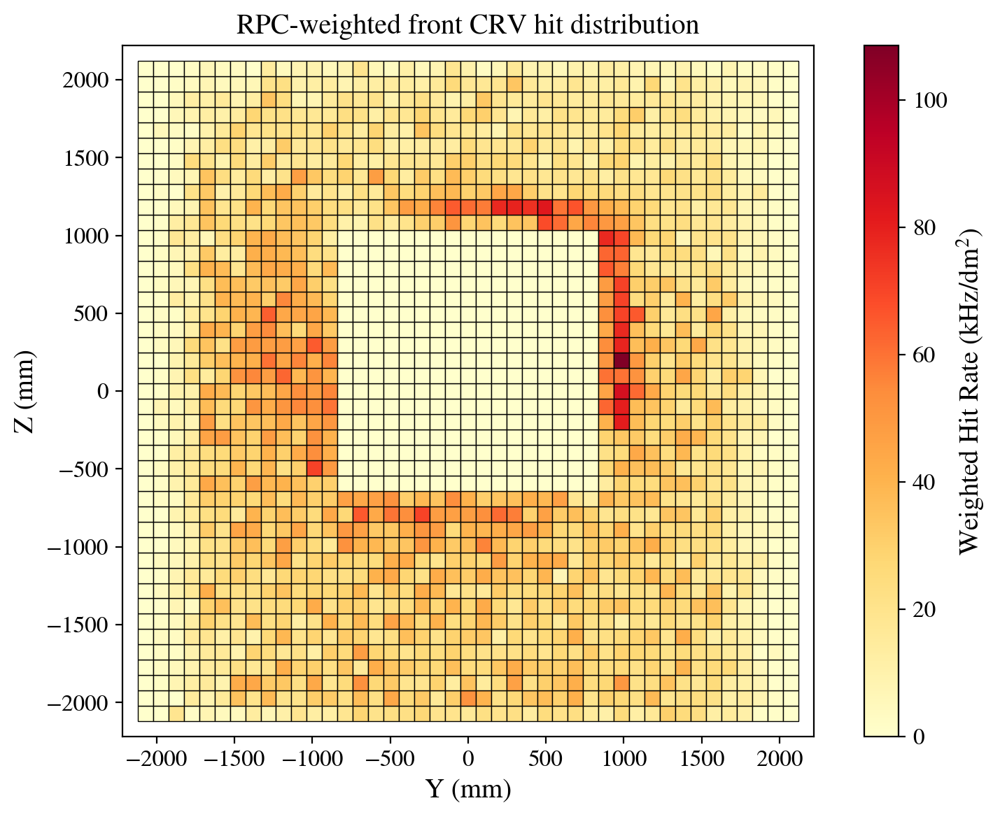

In [7]:
plot_grid_hitmap(frontcrv0, plotHits=False)

In [9]:
## 1 kHz/dm2 = 1000/100 Hz/cm2 = 10 Hz/cm2 

In [10]:
### For a 1e6 ns total duration (1e3*1e3 n_bunches * bunch_DT)
### and 1.63e7 POTs / bunch
### nbins = 1e6 (1 bin per ns)
### nsamples = 1.63e10 (1.63e7*1e3 (POTs/bunch)*n_bunches)

nbins = int(1e6) 
# nsamples = int(2*1e7)
nsamples = int(1e6)

tmod = frontcrv0.HitT[frontcrv0.HitT<=1e6]
print(len(tmod/1e3), len(frontcrv0.HitT/1e3))

pdf_t, xbins_t = getPDFfromDist(tmod, nbins)

160965 163669


In [11]:
t_gen = generateFromDist(tmod, nbins, nsamples)

pdf norm = 1.00e+00


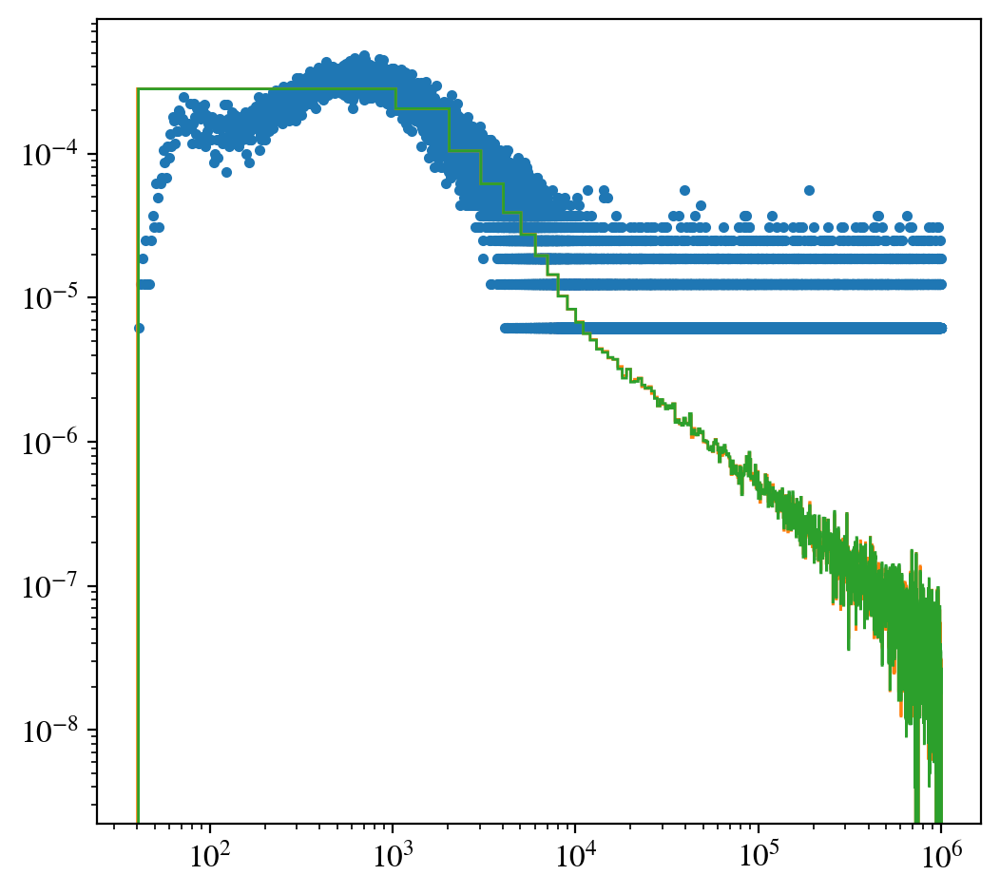

In [12]:

plt.plot(xbins_t, pdf_t, '.')
plt.hist(tmod, 1000, density=True, histtype='step')
plt.hist(t_gen, 1000, density=True, histtype='step')
plt.yscale('log')
# plt.xlim(0, 1e3)
plt.xscale('log')

In [13]:
nPOT = 99995000 
nPOTperBunch = int(1.63e7)
DT = 1316 ## ns, bunch interval
dT = 100 ## ns, pulse duration
nBunches = 1000

# Tmax = int(nBunches*DT)
nHits = len(frontcrv0.HitT)
nHitsPerPOT = nHits/nPOT
nHitsPerBunch = int(nHitsPerPOT*nPOTperBunch)
print(nHits, nHitsPerPOT, nHitsPerBunch)

163669 0.0016367718385919296 26679


In [14]:
### For a 1e6 ns total duration (1e3*1e3 n_bunches * bunch_DT)
### and 1.63e7 POTs / bunch
### nbins = 1e6 (1 bin per ns)
### nsamples = 1.63e10 (1.63e7*1e3 (POTs/bunch)*n_bunches)

nbins = int(1e6) 
nsamples = int(nHitsPerBunch*nBunches)
print(nsamples)

tmod = frontcrv0.HitT[frontcrv0.HitT<=1e6]
print(len(tmod/1e3), len(frontcrv0.HitT/1e3))

pdf_t, xbins_t = getPDFfromDist(tmod, nbins)
t_gen = generateFromDist(tmod, nbins, nsamples)

26679000
160965 163669
pdf norm = 1.00e+00


In [15]:
# bunchT = np.array([np.linspace(ibunch*DT, ibunch*DT + dT, nHitsPerBunch) for ibunch in range(nBunches)])
bunchT = np.array([np.random.uniform(ibunch*DT, ibunch*DT + dT, nHitsPerBunch) for ibunch in range(nBunches)])
bunchT_flat = bunchT.flatten()

len(bunchT_flat), len(t_gen), bunchT_flat[:3]

(26679000, 26679000, array([26.9932727 , 59.43405816, 96.37378949]))

In [16]:
### real time distribution (thit) over nBunches bunches
### = uniform distribution of POT t0 + custom distribution of thit-t0 

t_dist_real = bunchT_flat + t_gen

Text(0.5, 0, 'time (ns)')

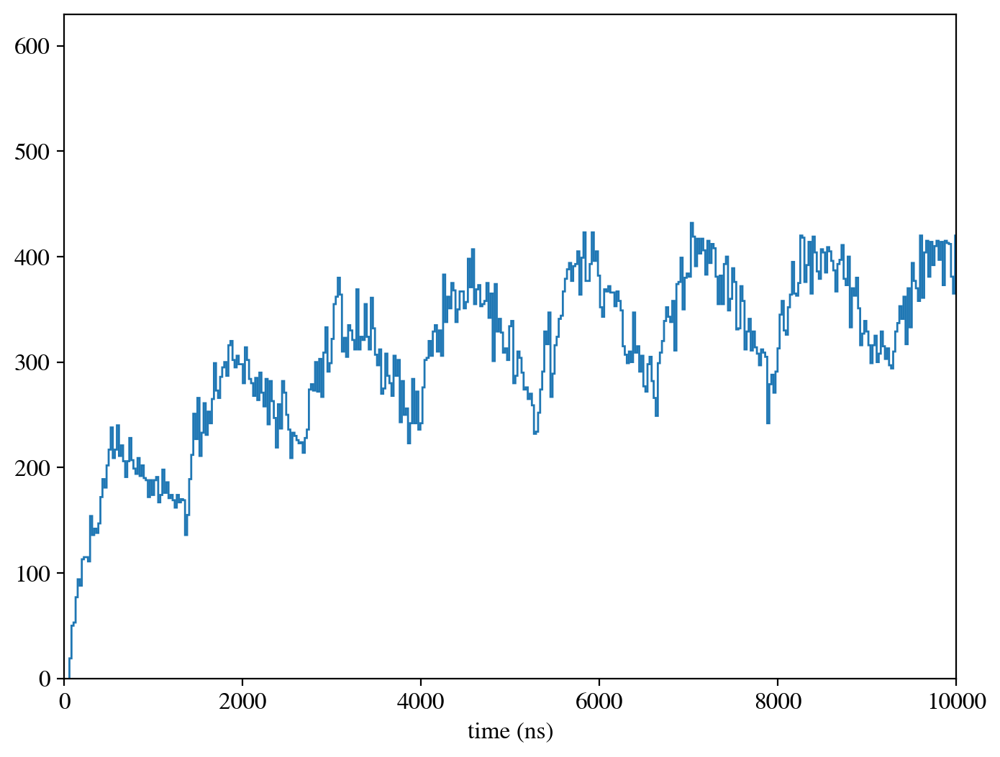

In [17]:
fig, ax = plt.subplots(figsize=(8, 6))
ax.hist(t_dist_real, int(1e5), histtype='step')
## show 3 bunches
# ax.set_xlim(0, int(3*DT))
ax.set_xlim(0, int(1e4))
ax.set_xlabel("time (ns)")

Text(0.5, 0, 'time (ns)')

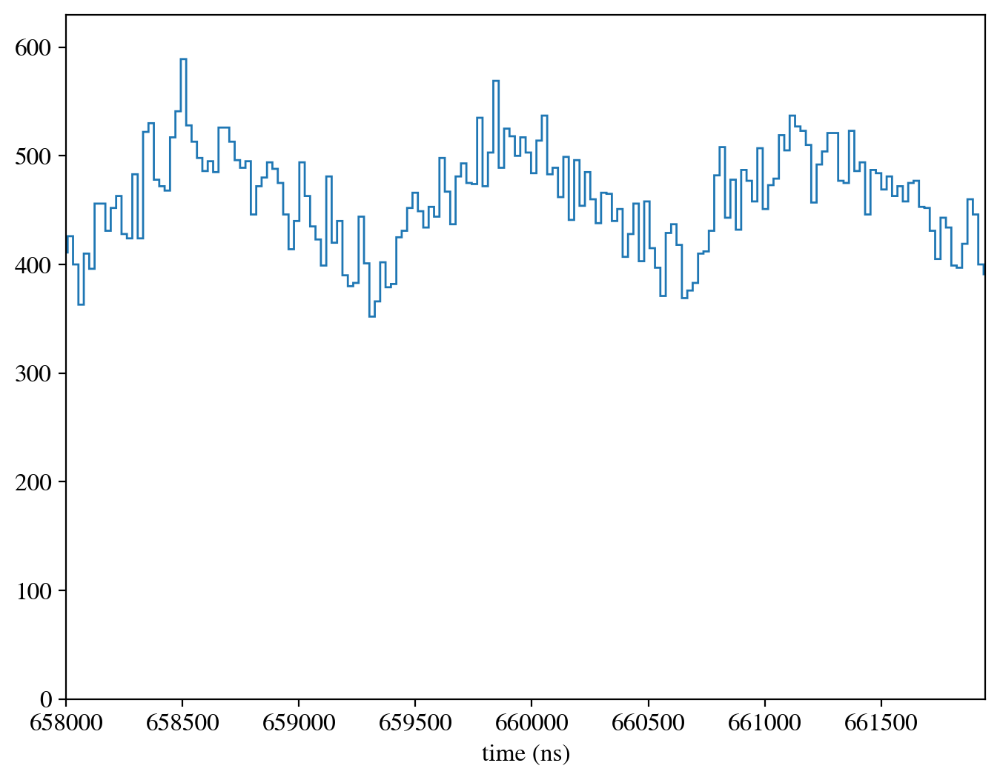

In [18]:
fig, ax = plt.subplots(figsize=(8, 6))
ax.hist(t_dist_real, int(1e5), histtype='step')
## show 3 bunches
# ax.set_xlim(0, int(3*DT))
ax.set_xlim(int(500*DT), int(503*DT))
ax.set_xlabel("time (ns)")

In [19]:
nbins = int(1e4)
nsamples = int(1e6)
# nsamples = int(nHitsPerBunch*nBunches)

xmod = frontcrv0.HitY[frontcrv0.HitT<=2e6]
ymod = frontcrv0.HitZ[frontcrv0.HitT<=2e6]

hist2d, xbins, ybins = getPDFfromDist_2D(xmod, ymod, nbins)
x_dist, y_dist = generateFromDist_2D(xmod, ymod, nbins, nsamples)

pdf norm = 6.18e+00


(array([-923.53976698,  917.40221183]),
 array([-722.75, 1135.75]),
 -3.0687775778600894,
 206.49999999999346,
 1840.9419788122018,
 1858.5)

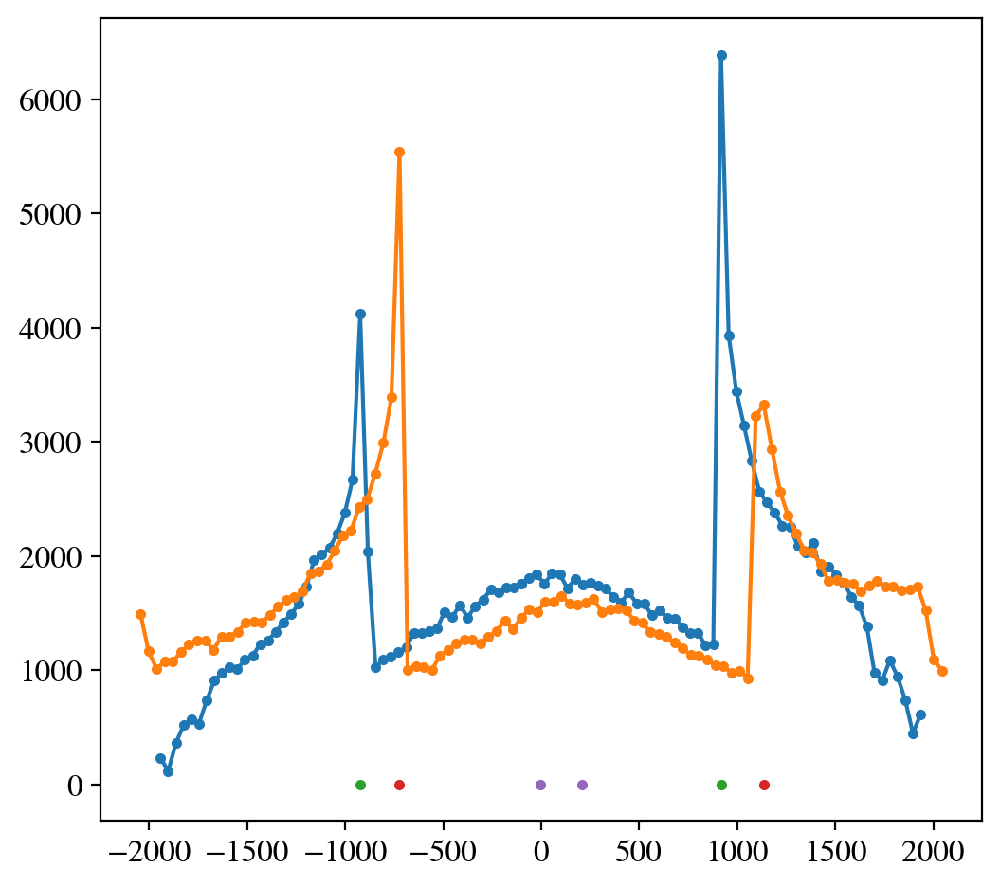

In [20]:
nbins = 100

yhist, ybins = np.histogram(xmod, nbins)
ybins = xBins(ybins)
zhist, zbins = np.histogram(ymod, nbins)
zbins = xBins(zbins)

iywin = [np.argmax(yhist[:nbins//2]), nbins//2 + np.argmax(yhist[nbins//2:])]
izwin = [np.argmax(zhist[:nbins//2]), nbins//2 + np.argmax(zhist[nbins//2:])]

ywin = ybins[iywin]
zwin = zbins[izwin]
ycenter = (ywin[0]+ywin[1])/2
zcenter = (zwin[0]+zwin[1])/2

ywinWidth = ywin[1]-ywin[0]
zwinWidth = zwin[1]-zwin[0]

plt.plot(ybins, yhist, '.-')
plt.plot(zbins, zhist, '.-')
plt.plot(ywin, [0, 0], '.')
plt.plot(zwin, [0, 0], '.')
plt.plot([ycenter, zcenter], [0, 0], '.')

ywin, zwin, ycenter, zcenter, ywinWidth, zwinWidth

In [21]:
ywinWidth, ywinWidth/(1+np.sqrt(2))

(1840.9419788122018, 762.543135165977)

In [22]:
# 11: electron
# 13: muon
# 22: photon
# 2112: neutron
# 2212: proton
# 1000010020: deuterium

In [95]:
def getCenterHitsFromMap(hitmap, ymin, ymax, zmin, zmax, particle=None):

    HitT = hitmap.HitT
    HitX = hitmap.HitX
    HitY = hitmap.HitY
    HitZ = hitmap.HitZ
    IsFirstHit = hitmap.IsFirstHit
    PID = hitmap.treeFront_arr.PID[IsFirstHit==True]
    # Rho = np.sqrt(HitY**2 + HitZ**2)

    if particle=='neutrons':
        ymod = HitY[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax) & (PID==2112)]
        zmod = HitZ[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax) & (PID==2112)]
    elif particle=='gamma':
        ymod = HitY[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax) & (PID==22)]
        zmod = HitZ[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax) & (PID==22)]
    else:
        ymod = HitY[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax)]
        zmod = HitZ[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax)]

    return ymod, zmod

def getCenterHits(ymin, ymax, zmin, zmax, particle=None):

    HitT = frontcrv0.HitT
    HitX = frontcrv0.HitX
    HitY = frontcrv0.HitY
    HitZ = frontcrv0.HitZ
    IsFirstHit = frontcrv0.IsFirstHit
    PID = frontcrv0.treeFront_arr.PID[IsFirstHit==True]
    # Rho = np.sqrt(HitY**2 + HitZ**2)

    if particle=='neutrons':
        ymod = HitY[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax) & (PID==2112)]
        zmod = HitZ[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax) & (PID==2112)]
    elif particle=='gamma':
        ymod = HitY[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax) & (PID==22)]
        zmod = HitZ[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax) & (PID==22)]
    else:
        ymod = HitY[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax)]
        zmod = HitZ[(HitT<=2e6) & (HitY>=ymin) & (HitY<=ymax) & (HitZ>=zmin) & (HitZ<=zmax)]

    return ymod, zmod


def getCenterHits_2(rhomax, yoff, zoff, particle=None):

    HitT = frontcrv0.HitT
    HitX = frontcrv0.HitX
    HitY = frontcrv0.HitY - yoff
    HitZ = frontcrv0.HitZ - zoff
    IsFirstHit = frontcrv0.IsFirstHit
    PID = frontcrv0.treeFront_arr.PID[IsFirstHit==True]
    Rho = np.sqrt(HitY**2 + HitZ**2)

    if particle=='neutrons':
        ymod = HitY[(HitT<=2e6) & (Rho<=rhomax) & (PID==2112)]
        zmod = HitZ[(HitT<=2e6) & (Rho<=rhomax) & (PID==2112)]
    elif particle=='gamma':
        ymod = HitY[(HitT<=2e6) & (Rho<=rhomax) & (PID==22)]
        zmod = HitZ[(HitT<=2e6) & (Rho<=rhomax) & (PID==22)]
    else:
        ymod = HitY[(HitT<=2e6) & (Rho<=rhomax)]
        zmod = HitZ[(HitT<=2e6) & (Rho<=rhomax)]

    return ymod, zmod

In [24]:
octoStripWidth = 370
yoff = 0
zoff = 200
# yabs = zwinWidth/2 + octoStripWidth
yabs = 1200
print(yabs)
rhomax = 950

ymin, ymax = -yabs + yoff, yabs + yoff
zmin, zmax = -yabs + zoff, yabs + zoff

y_neu, z_neu = getCenterHits(ymin, ymax, zmin, zmax, 'neutrons')
y_pho, z_pho = getCenterHits(ymin, ymax, zmin, zmax, 'gamma')
y_all, z_all = getCenterHits(ymin, ymax, zmin, zmax)

y_neu, z_neu = y_neu - yoff, z_neu - zoff
y_pho, z_pho = y_pho - yoff, z_pho - zoff
y_all, z_all = y_all - yoff, z_all - zoff

len(y_neu), len(y_pho), len(y_all)

1200


(53677, 12451, 66473)

In [25]:
y_neu_rho, z_neu_rho = getCenterHits_2(rhomax, yoff, zoff, 'neutrons')
y_pho_rho, z_pho_rho = getCenterHits_2(rhomax, yoff, zoff, 'gamma')
y_all_rho, z_all_rho = getCenterHits_2(rhomax, yoff, zoff)

96.45036386516294 -43.79439761873482


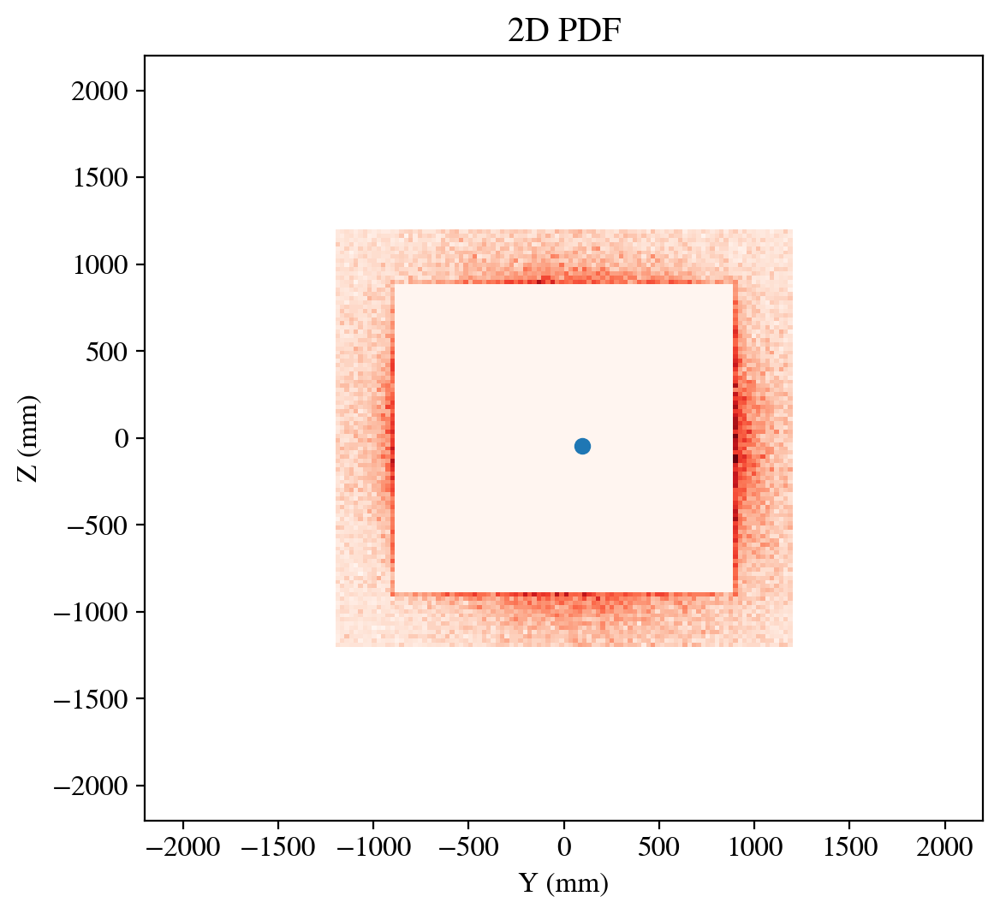

In [26]:
nbins = 100
# norm = mcolors.Normalize(vmin=0, vmax=pdf.max())
# norm = mcolors.LogNorm(vmin=, vmax=pdf.max())
# Call your function
# pdf, xcenters, ycenters = getPDFfromDist_2D(x_data, y_data, nbins=1000)

# pdf, x_edges, y_edges = np.histogram2d(y_pho, z_pho, 100)
# pdf, x_edges, y_edges = np.histogram2d(y_neu, z_neu, 100)
pdf, x_edges, y_edges = np.histogram2d(y_all, z_all, 100)
# pdf, x_edges, y_edges = np.histogram2d(y_all_rho, z_all_rho, 100)

y0_beam, z0_beam = np.mean(y_all), np.mean(z_all)

# Create meshgrid for pcolormesh
X, Y = np.meshgrid(x_edges, y_edges)

# Plot
plt.figure(figsize=(6, 5.5))
# pcm = plt.pcolormesh(X, Y, pdf.T, cmap='Reds', shading='auto')  # note: transpose
# plt.hist2d(y_all_rho, z_all_rho, 100, cmap="Reds")
plt.hist2d(y_all, z_all, nbins, cmap="Reds")
plt.plot(y0_beam, z0_beam, 'o', c='tab:blue')
print(y0_beam, z0_beam)
plt.xlabel("Y (mm)")
plt.ylabel("Z (mm)")
plt.title("2D PDF")
# plt.colorbar(pcm, label='Probability Density')
plt.tight_layout()

plt.xlim(-2200, 2200)
plt.ylim(-2200, 2200)
plt.show()


In [27]:
len(y_all), len(z_all)

(66473, 66473)

In [28]:
# y_all2 = generateFromDist(y_all-yoff, 1000, 100000)
# z_all2 = generateFromDist(z_all-zoff, 1000, 100000)
y_all2 = generateFromDist(y_all, 1000, len(y_all))
z_all2 = generateFromDist(z_all, 1000, len(y_all))

pdf norm = 4.17e-01
pdf norm = 4.17e-01


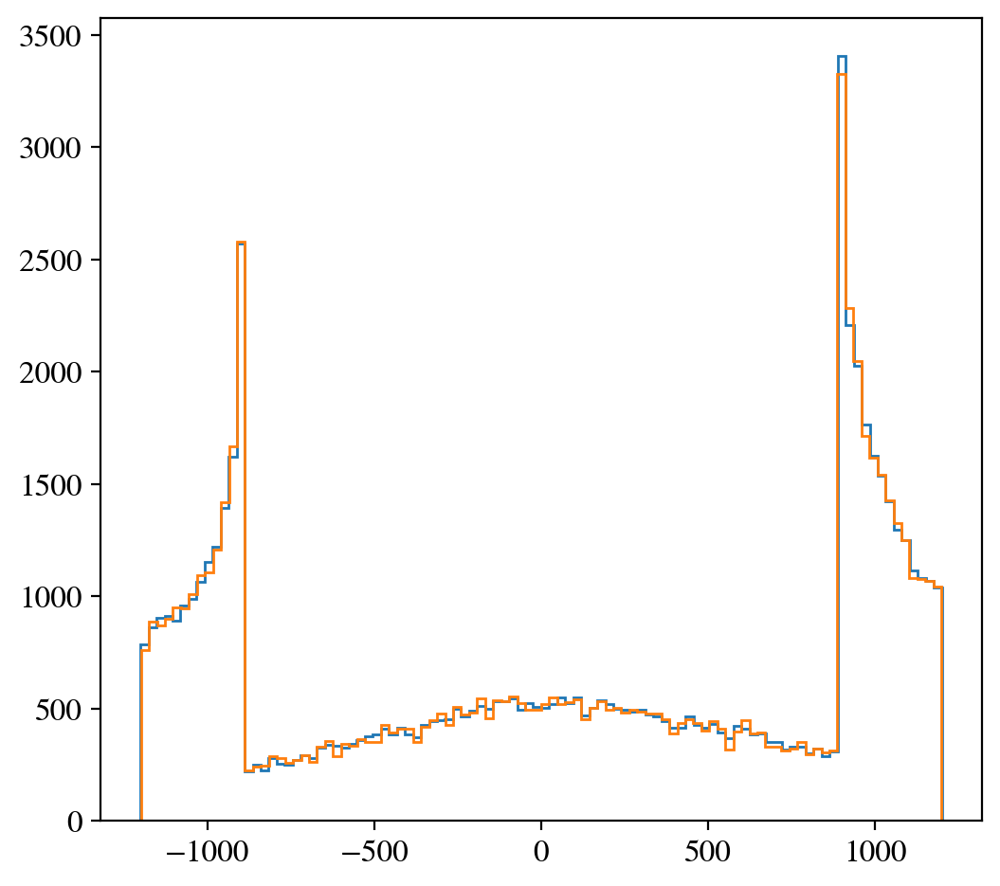

In [29]:
plt.hist(y_all, 100, histtype='step')
plt.hist(y_all2, 100, histtype='step')
# plt.hist(z_all, 100, histtype='step')
# plt.hist(z_all2, 100, histtype='step')
plt.show()

In [30]:
### polar coordonitate in beam frame
# rho = np.sqrt((y_all-y0_beam)**2 + (z_all-z0_beam)**2)
# phi = np.arctan2(z_all-z0_beam, y_all-y0_beam)

rho = np.sqrt(y_all**2 + z_all**2)
phi = np.arctan2(z_all, y_all)
print(len(phi))

rho_neu = np.sqrt(y_neu**2 + z_neu**2)
phi_neu = np.arctan2(z_neu, y_neu)

rho_pho = np.sqrt(y_pho**2 + z_pho**2)
phi_pho = np.arctan2(z_pho, y_pho)

# rho = np.sqrt(y_all_rho**2 + z_all_rho**2)
# phi = np.arctan2(z_all_rho, y_all_rho)

phi_new = generateFromDist(phi, 1000, len(phi))
rho_new = generateFromDist(rho, 1000, len(phi))

print("")

66473
pdf norm = 1.59e+02
pdf norm = 1.26e+00



In [31]:
def square_ring_mask(x, y, D):
    R = D / 2
    inside_square = (np.abs(x) <= R) & (np.abs(y) <= R)
    outside_circle = (x**2 + y**2) >= R**2
    return inside_square & outside_circle

def square_frame_mask(x, y, l, L):
    d1 = l/2
    d2 = L/2
    toporbot = (np.abs(x)<d2) & (np.abs(y)<d2) & (np.abs(y)>=d1)
    leftorright = (np.abs(y)<d2) & (np.abs(x)<d2) & (np.abs(x)>=d1)
    return toporbot | leftorright

def generateFromDist_2D_masked(x_data, y_data, nbins, nsamples, l, L):
    """
    mask_fn: function that takes (x, y) arrays and returns a boolean mask of valid points
    """
    hist2d, xbins, ybins = getPDFfromDist_2D(x_data, y_data, nbins)
    pdf = hist2d.flatten()
    norm = np.sum(pdf)
    print("pdf norm = {:.2e}".format(norm))
    cdf = np.cumsum(pdf) / norm

    ring_x = []
    ring_y = []
    frame_x = []
    frame_y = []

    batch_size = nsamples  # Sample in chunks
    while len(frame_x) < nsamples:
        x_try, y_try = invCDFGen_2D(cdf, xbins, ybins, batch_size, hist2d.shape)
        frame_mask = square_frame_mask(x_try, y_try, l, L)
        ring_mask = square_ring_mask(x_try, y_try, l)
        ring_x.extend(x_try[ring_mask])
        ring_y.extend(y_try[ring_mask])
        frame_x.extend(x_try[frame_mask])
        frame_y.extend(y_try[frame_mask])
    n_frame = len(frame_x)
    n_ring = len(ring_x)
    print(nsamples)
    print(n_frame)
    print(n_ring)
    if n_frame>nsamples:
        frameRingRatio = n_ring/n_frame
        nsamples_ring = int(frameRingRatio*nsamples)
        print(nsamples_ring)
        frame_x, frame_y = np.array(frame_x[:nsamples]), np.array(frame_y[:nsamples])
        ring_x, ring_y = np.array(ring_x[:nsamples_ring]), np.array(ring_y[:nsamples_ring])
    return ring_x, ring_y, frame_x, frame_y



In [32]:
square_ring_mask(np.array([0, 4]), np.array([0, 4]), 10)

array([False,  True])

pdf norm = 1.59e+02
pdf norm = 1.26e+00
n_square_frame = 66352
pdf norm = 8.93e-02
66352
80156
30429
25188
n_ring_frame = 25188
n_square_frame = 66352


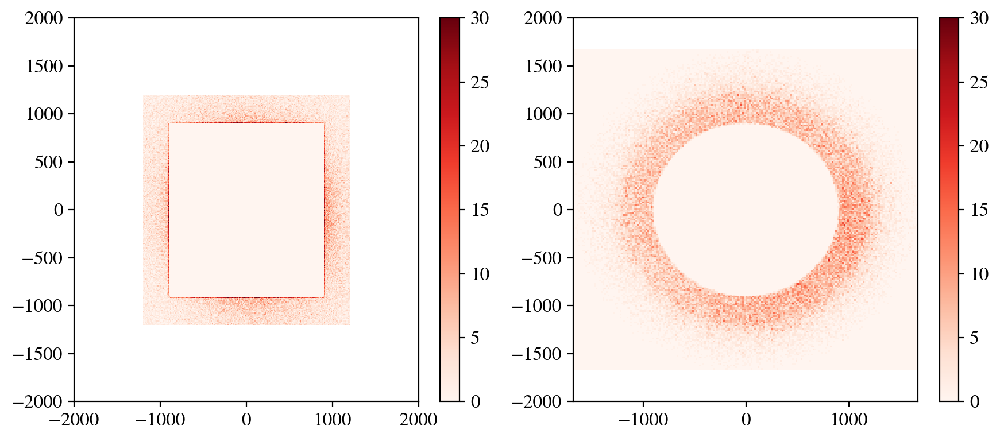

In [33]:
yoff = -3
zoff = 206
nbins = 1000 # for inverse transform sampling
l = 1800
L = 2400
norm = mcolors.Normalize(vmin=0, vmax=30)

yabs = L//2
ymin, ymax = -yabs + yoff, yabs + yoff
zmin, zmax = -yabs + zoff, yabs + zoff

## get hits inside square frame in centered cartesian frame
y_all, z_all = getCenterHits(ymin, ymax, zmin, zmax)
y_all, z_all = y_all - yoff, z_all - zoff

## 1D radial generation
nsamples = len(y_all)
rho = np.sqrt(y_all**2 + z_all**2)
phi = np.arctan2(z_all, y_all)
phi_new = generateFromDist(phi, nbins, nsamples)
rho_new = generateFromDist(rho, nbins, nsamples)

## y,z from radial generation
y_new = rho_new*np.cos(phi_new)
z_new = rho_new*np.sin(phi_new)

fig, axs = plt.subplots(1, 2, tight_layout=True, figsize=(9,4))
hist = axs[0].hist2d(y_all, z_all, 200, cmap='Reds', shading='auto', alpha=1, norm=norm)
hist2 = axs[1].hist2d(y_new, z_new, 200, cmap='Reds', shading='auto', alpha=1, norm=norm)
axs[0].set_xlim(-2000, 2000)
axs[0].set_ylim(-2000, 2000)
axs[1].set_ylim(-2000, 2000)
axs[1].set_ylim(-2000, 2000)
plt.colorbar(hist[3], ax=axs[0])
plt.colorbar(hist2[3], ax=axs[1])


print("n_square_frame = {}".format(nsamples))
y_ring, z_ring, y_frame, z_frame = generateFromDist_2D_masked(y_new, z_new, nbins, nsamples, l, L)
print("n_ring_frame = {}".format(len(y_ring)))
print("n_square_frame = {}".format(len(y_frame)))

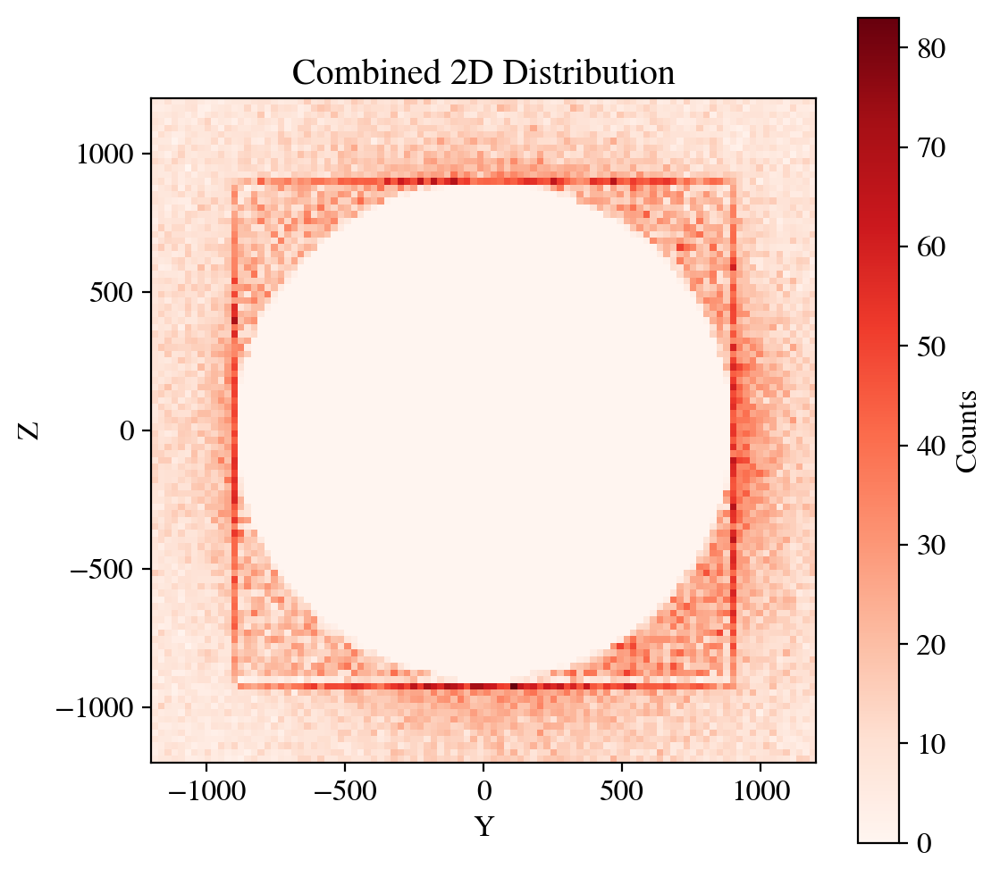

In [86]:
# Combine data
y_combined = np.concatenate([y_all, y_ring])
z_combined = np.concatenate([z_all, z_ring])
# y_combined = np.concatenate([y_all])
# z_combined = np.concatenate([z_all])

# Plot combined distribution
plt.figure(figsize=(6, 6))
plt.hist2d(y_combined, z_combined, bins=100, cmap="Reds")
# plt.hist2d(y_frame, z_frame, bins=100, cmap="Reds")
plt.gca().set_aspect("equal")
plt.xlabel("Y")
plt.ylabel("Z")
plt.title("Combined 2D Distribution")
plt.colorbar(label="Counts")
plt.show()


25188
163669


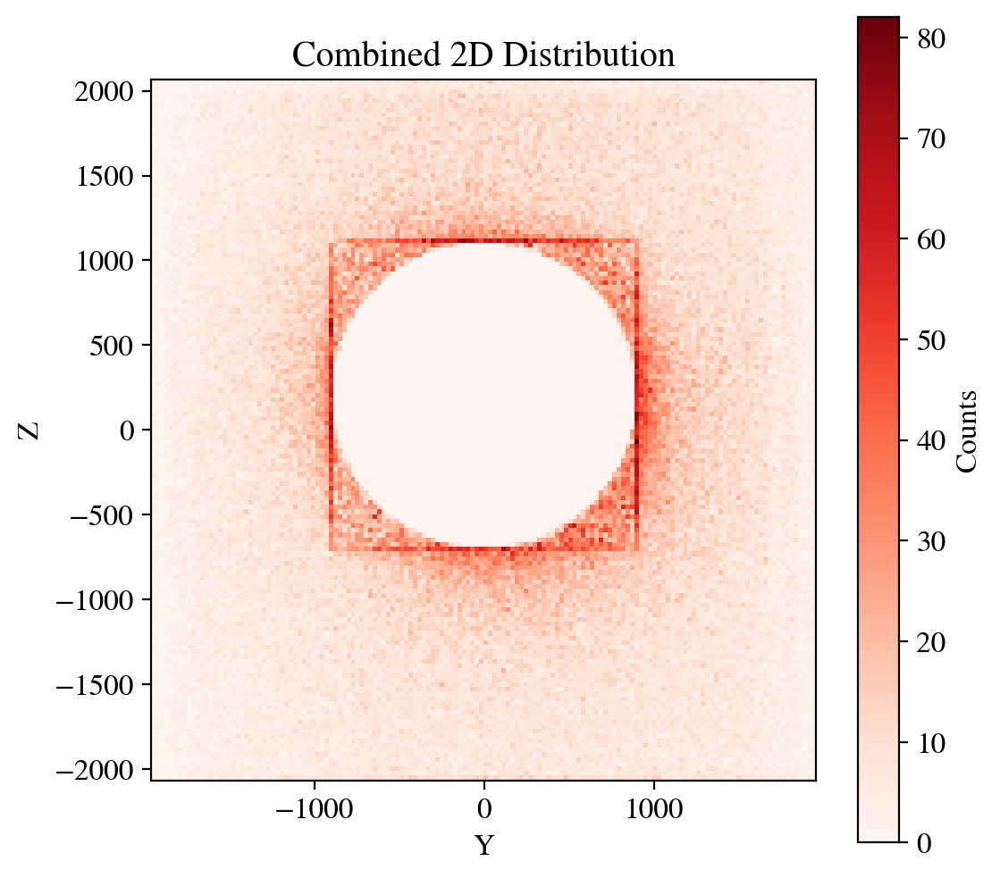

In [90]:
# Combine data
y_ring_real = y_ring + yoff
z_ring_real = z_ring + zoff
print(len(y_ring_real))
y_all_real = frontcrv0.HitY
z_all_real = frontcrv0.HitZ
print(len(y_all_real))
y_combined = np.concatenate([y_all_real, y_ring_real])
z_combined = np.concatenate([z_all_real, z_ring_real])
# y_combined = np.concatenate([y_all])
# z_combined = np.concatenate([z_all])

# Plot combined distribution
plt.figure(figsize=(6, 6))
plt.hist2d(y_combined, z_combined, bins=150, cmap="Reds")
# plt.hist2d(y_all_real, z_all_real, bins=150, cmap="Reds")
plt.gca().set_aspect("equal")
plt.xlabel("Y")
plt.ylabel("Z")
plt.title("Combined 2D Distribution")
plt.colorbar(label="Counts")
plt.show()


(-2000.0, 2000.0)

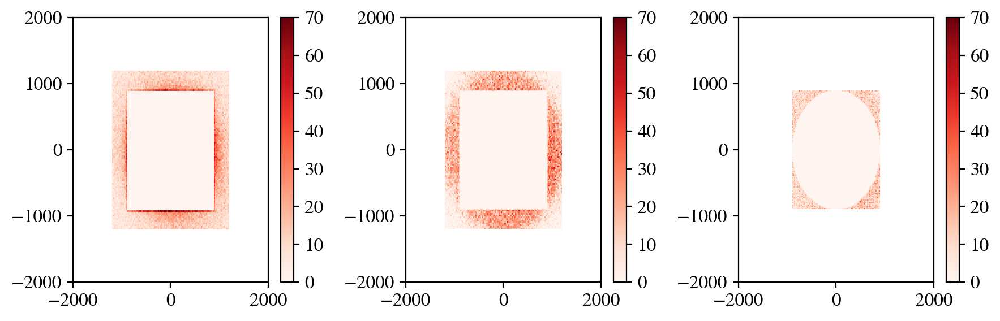

In [35]:
vmin, vmax = 0, 70
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

fig, axs = plt.subplots(1, 3, tight_layout=True, figsize=(9,3))

hist = axs[0].hist2d(y_all, z_all, 100, cmap='Reds', shading='auto', alpha=1, norm=norm)
hist2 = axs[1].hist2d(y_frame, z_frame, 100, cmap='Reds', shading='auto', alpha=1, norm=norm)
hist3 = axs[2].hist2d(y_ring, z_ring, 100, cmap='Reds', shading='auto', alpha=1, norm=norm)

# plt.pcolormesh(X, Y, pdf.T, cmap='Blues', shading='auto', alpha=0.5)  # note: transpose

plt.colorbar(hist[3], ax=axs[0])
plt.colorbar(hist2[3], ax=axs[1])
plt.colorbar(hist3[3], ax=axs[2])

axs[0].set_xlim(-2000, 2000)
axs[0].set_ylim(-2000, 2000)
axs[1].set_xlim(-2000, 2000)
axs[1].set_ylim(-2000, 2000)
axs[2].set_xlim(-2000, 2000)
axs[2].set_ylim(-2000, 2000)

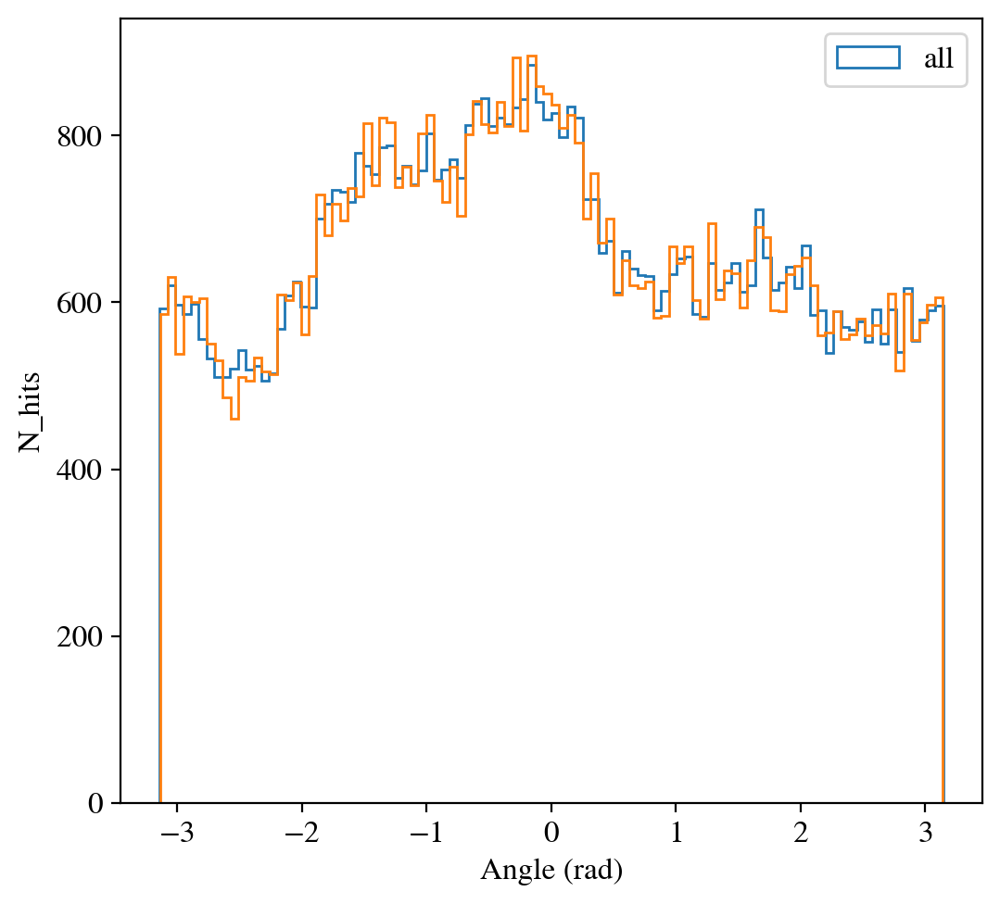

In [36]:
plt.hist(phi, 100, histtype='step', label='all')
# plt.hist(phi_neu, 100, histtype='step', label='neutrons')
# plt.hist(phi_pho, 100, histtype='step', label='photons')
plt.hist(phi_new, 100, histtype='step')
plt.xlabel('Angle (rad)')
plt.ylabel('N_hits')
plt.legend()
print("")

In [37]:
frontcrv1b = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [38]:
nbins = int(1e4)
nsamples = int(1e6)
# nsamples = int(nHitsPerBunch*nBunches)

xmod = frontcrv1b.HitY[frontcrv1b.HitT<=2e6]
ymod = frontcrv1b.HitZ[frontcrv1b.HitT<=2e6]

hist2d, xbins, ybins = getPDFfromDist_2D(xmod, ymod, nbins)
x_dist, y_dist = generateFromDist_2D(xmod, ymod, nbins, nsamples)

pdf norm = 6.18e+00


In [39]:
# moduleL = 3000
# modulel = 1240
moduleL = 2740
modulel = 4240-moduleL
moduleL, modulel

(2740, 1500)

In [40]:
nstrips = 48*2 ## n_strips/module
side_length = moduleL+modulel
side_length//2, nstrips

(2120, 96)

In [41]:
## scaled nHits for redistribution 
nHits_b = int(1e6)
nPOT_b = nHits_b / nHitsPerPOT

nHits/1e6, len(x_dist)/1e6, nPOT/1e6, nPOT_b/1e6

(0.163669, 1.0, 99.995, 610.95870323641)

pdf norm = 1.15e+05



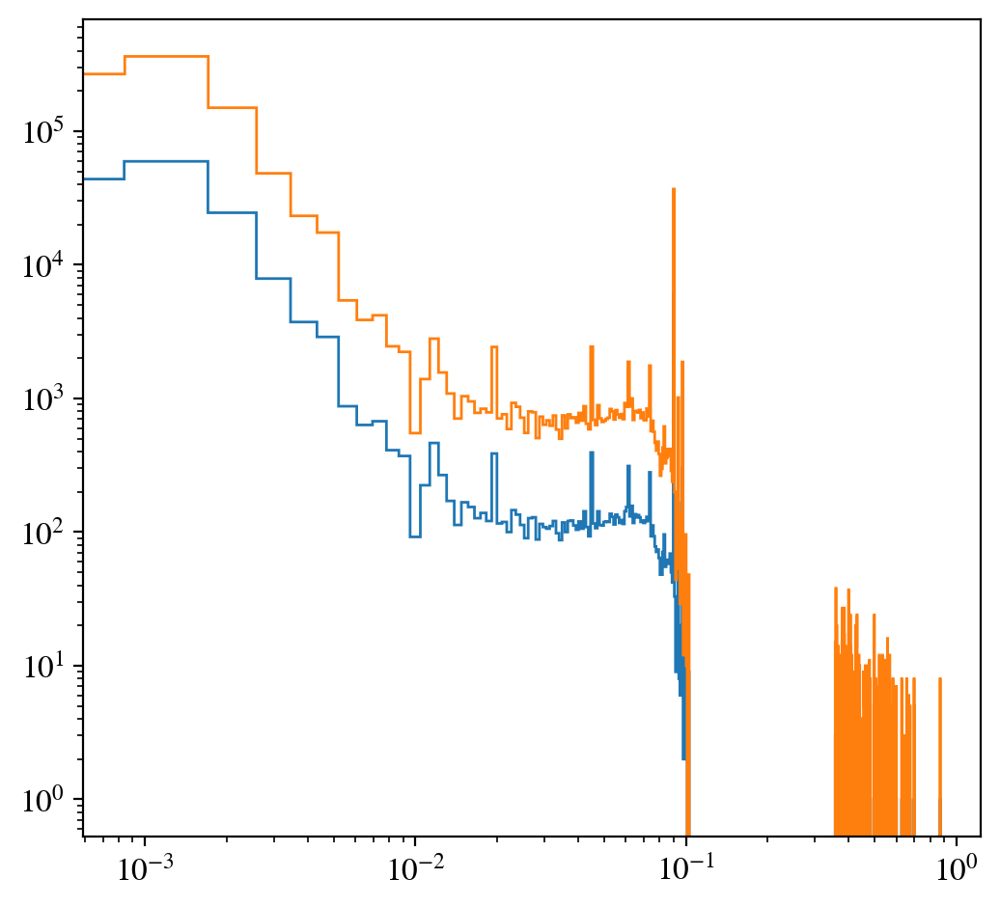

In [42]:
weights_dist = generateFromDist(frontcrv1b.RPCweights, int(1e5), int(1e6))

plt.hist(frontcrv1b.RPCweights, bins=1000, histtype='step')
plt.hist(weights_dist, bins=1000, histtype='step')
plt.xscale('log')
plt.yscale('log')
print("")

In [43]:
### use generated YZ hits and generated weights instead, and scale number of POTs.
frontcrv1b.HitY = x_dist
frontcrv1b.HitZ = y_dist
frontcrv1b.RPCweights = weights_dist
frontcrv1b.nPOT = nPOT_b
frontcrv1b.nhits = nHits_b

In [44]:
frontcrv1b.getGeometry(nstrips=96, xmin=-2120, xmax=2120, ymin=-2120, ymax=2120, L=moduleL, l=modulel, geo_type='rectangular strips 1')
frontcrv1b.getHitsPerChannel()

Rectangular module dimensions: L = 2740, l = 1500, D = 4240


In [45]:
frontcrv1b.hitRateFactor

4091.9295964798243

In [46]:
HitRateArr = []
for i in range(frontcrv1b.geometry.nstrips):
    HitRateArr.append(frontcrv1b.module1Hits[i])
    HitRateArr.append(frontcrv1b.module2Hits[i])
    HitRateArr.append(frontcrv1b.module3Hits[i])
    HitRateArr.append(frontcrv1b.module4Hits[i])
AvgHitRatePerStrip1b = np.mean(HitRateArr)
AvgHitRatePerStrip1b/1000

93.40369125861466

AvgHitRatePerStrip = 93.40 kHz
max_hit_rate = 199.21 kHz/strip


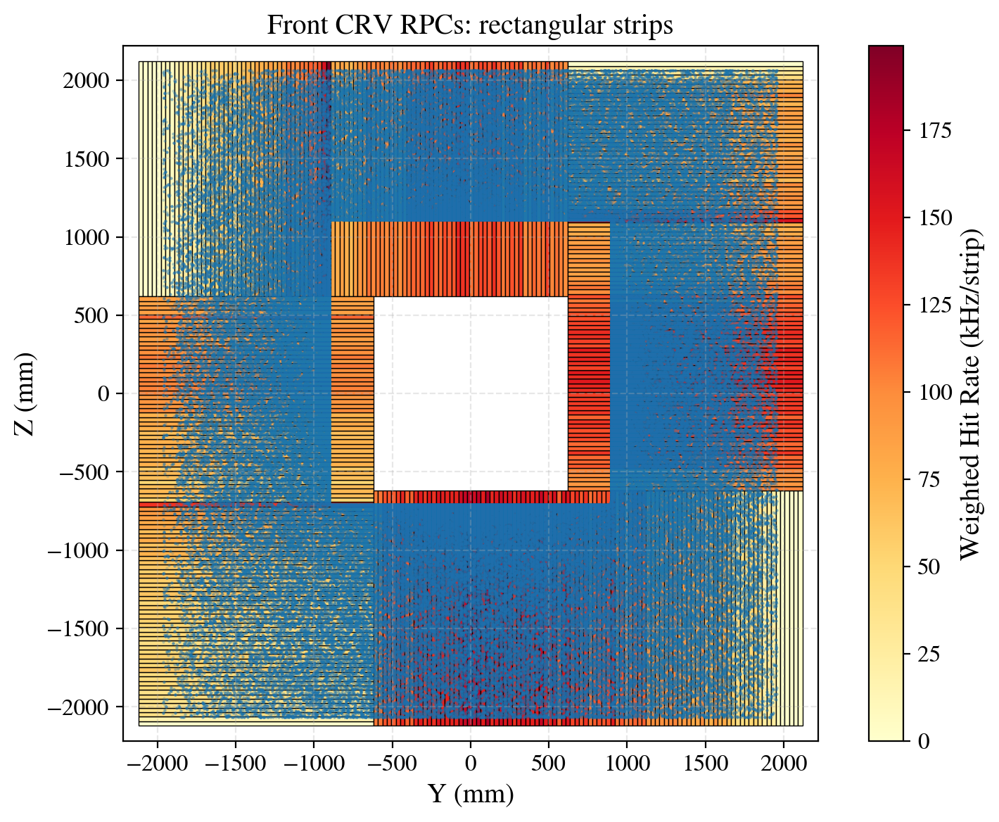

In [47]:
print("AvgHitRatePerStrip = {:.2f} kHz".format(AvgHitRatePerStrip1b/1000))
plot_strip_hitmap(frontcrv1b, plotHits=True)

In [48]:
frontcrv1 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [49]:
frontcrv1.getGeometry(nstrips=96, xmin=-2120, xmax=2120, ymin=-2120, ymax=2120, L=moduleL, l=modulel, geo_type='rectangular strips 1')
frontcrv1.getHitsPerChannel()

Rectangular module dimensions: L = 2740, l = 1500, D = 4240


In [50]:
HitRateArr = []
for i in range(frontcrv1.geometry.nstrips):
    HitRateArr.append(frontcrv1.module1Hits[i])
    HitRateArr.append(frontcrv1.module2Hits[i])
    HitRateArr.append(frontcrv1.module3Hits[i])
    HitRateArr.append(frontcrv1.module4Hits[i])
AvgHitRatePerStrip1 = np.mean(HitRateArr)
AvgHitRatePerStrip1/1000

93.14396670898999

In [51]:
frontcrv1.geometry.L, frontcrv1.hitRateFactor

(2740, 25001.250062503124)

AvgHitRatePerStrip = 93.14 kHz
max_hit_rate = 205.71 kHz/strip


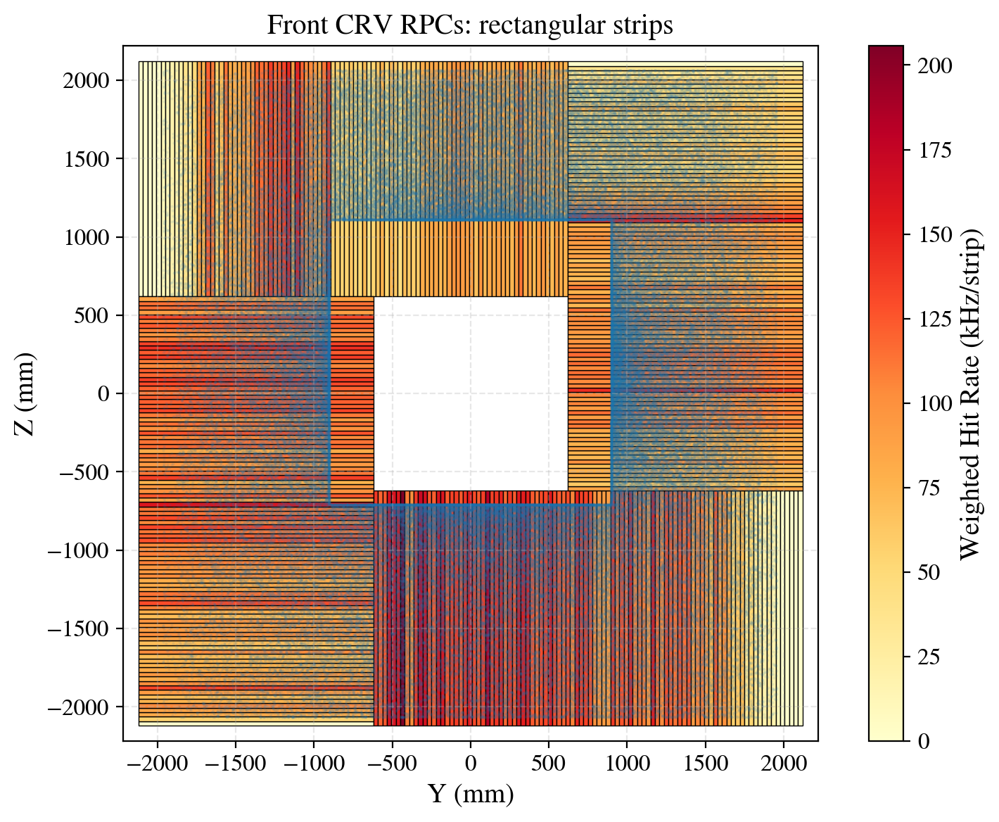

In [52]:
print("AvgHitRatePerStrip = {:.2f} kHz".format(AvgHitRatePerStrip1/1000))
plot_strip_hitmap(frontcrv1, plotHits=True)

In [53]:
frontcrv2 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [54]:
frontcrv2.getGeometry(nstrips=96, xmin=-2120, xmax=2120, ymin=-2120, ymax=2120, L=moduleL, l=modulel, geo_type='rectangular strips 2')
frontcrv2.getHitsPerChannel()

Rectangular module dimensions: L = 2740, l = 1500, D = 4240


In [55]:
HitRateArr = []
for i in range(frontcrv2.geometry.nstrips):
    HitRateArr.append(frontcrv2.module1Hits[i])
    HitRateArr.append(frontcrv2.module2Hits[i])
    HitRateArr.append(frontcrv2.module3Hits[i])
    HitRateArr.append(frontcrv2.module4Hits[i])
AvgHitRatePerStrip2 = np.mean(HitRateArr)
AvgHitRatePerStrip2/1000

93.14396670899

AvgHitRatePerStrip = 93.14 kHz
max_hit_rate = 425.99 kHz/strip


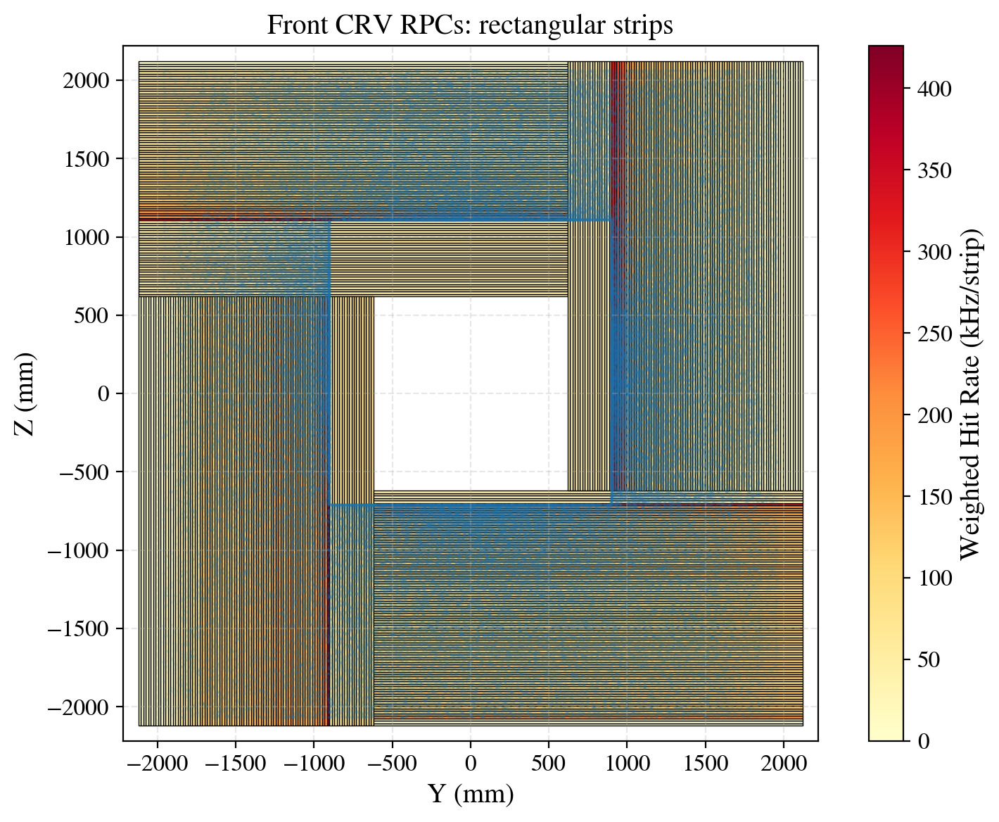

In [56]:
print("AvgHitRatePerStrip = {:.2f} kHz".format(AvgHitRatePerStrip2/1000))
plot_strip_hitmap(frontcrv2, plotHits=True)

In [57]:
hole_side = side_length - 2*modulel ## side length of hole
moduleH = (side_length - hole_side)//2 ## trapezoid height in trapezoidal geo

hole_side, moduleH

(1240, 1500)

In [58]:
moduleL+modulel, moduleL-modulel

(4240, 1240)

In [59]:
740 * (1+np.sqrt(2))/2

893.2590180780451

In [60]:
def trapezeL(l, H, alpha):
    return l + 2*H*np.tan(alpha)

def trapezeL_2(l, H, d):
    return 2*np.sqrt(d**2 - H**2) + l

def octoR(l):
    return l*(1+np.sqrt(2))/2

def octol(R):
    return R/(1+np.sqrt(2))

def trapezeAlpha(l, L, H):
    y = (L-l)/2
    x = H
    return np.arctan2(y, x)

def trapezeH(l, L, alpha):
    return (L-l) / (2*np.tan(alpha))

In [61]:
def getT2T3fromT1_b(R, L1, h1, gamma, h3):
    l = 2*R/(1+np.sqrt(2))
    d1 = np.sqrt(((L1-l)/2)**2 + h1**2)
    # alpha1 = np.arctan((L1-l)/(2*h1)) + np.pi/2
    # alpha2 = np.pi + gamma - np.arctan((L1-l)/(2*h1)) - np.pi/2
    # e2 = np.sqrt(((L1-l)/2)**2 + h1**2)*np.sin(np.pi + gamma - np.arctan((L1-l)/(2*h1)))
    h2 = np.sqrt(((L1-l)/2)**2 + h1**2)*np.cos(gamma - np.arctan((L1-l)/(2*h1)))
    L2 = (R + h3 - L1/2)/np.cos(gamma)
    # f2 = (R + h3 - L1/2)/np.cos(gamma) - np.sqrt(((L1-l)/2)**2 + h1**2)*np.sin(np.pi + gamma - np.arctan((L1-l)/(2*h1))) - l
    d2 = np.sqrt(((R + h3 - L1/2)/np.cos(gamma) - np.sqrt(((L1-l)/2)**2 + h1**2)*np.sin(gamma - np.arctan((L1-l)/(2*h1))) - l)**2 + (np.sqrt(((L1-l)/2)**2 + h1**2)*np.cos(gamma - np.arctan((L1-l)/(2*h1))))**2)
    L3 = 2*np.sqrt((np.sqrt(((R + h3 - L1/2)/np.cos(gamma) - np.sqrt(((L1-l)/2)**2 + h1**2)*np.sin(gamma - np.arctan((L1-l)/(2*h1))) - l)**2 + (np.sqrt(((L1-l)/2)**2 + h1**2)*np.cos(gamma - np.arctan((L1-l)/(2*h1))))**2))**2 - h3**2) + l
    return l, d1, h2, d2, L2, L3

In [62]:
getT2T3fromT1(900, 2000, 1000, np.pi/4, 1300)

(alpha1, alpha2, beta2) = (0.68, 0.571687, 0.671512) pi


(745.5844122715712,
 1180.4192546227018,
 1150.6096654409878,
 1340.546508094921,
 1697.056274847714,
 1399.9999999999989)

In [63]:
getT2T3fromT1_b(900, 2000, 1000, np.pi/4, 1300)

(745.5844122715712,
 1180.4192546227018,
 1150.6096654409878,
 1340.546508094921,
 1697.056274847714,
 1399.9999999999989)

(alpha1, alpha2, beta2) = (0.68, 0.571687, 0.671512) pi
l, d1, h2, d2, L2, L3 = 
745.5844122715712 1180.4192546227018 1150.6096654409878 1340.546508094921 1697.056274847714 1399.9999999999989
(alpha1, alpha2, beta2) = (0.58, 0.671512, 0.723070) pi
l, d3, h4, d4, L4, L5 = 
745.5844122715712 1340.546508094921 1150.6096654409876 1505.3842774586826 2404.163056034262 999.9999999999973
Isosceles sides: 1195.738924415479 1195.738924415479
Right given: 1180.4192546227018
-> Left length: 1370.5345024589503
Isosceles sides: 1347.7539199866696 1347.7539199866696
Right given: 1340.546508094921
-> Left length: 1542.5909204552026
Isosceles sides: 1508.0473018081584 1508.0473018081584
Left given: 1180.4192546227018
-> Right length: 1370.5345024589503
Isosceles sides: 1347.7539199866699 1347.7539199866699
Left given: 1340.546508094921
-> Right length: 1542.590920455202


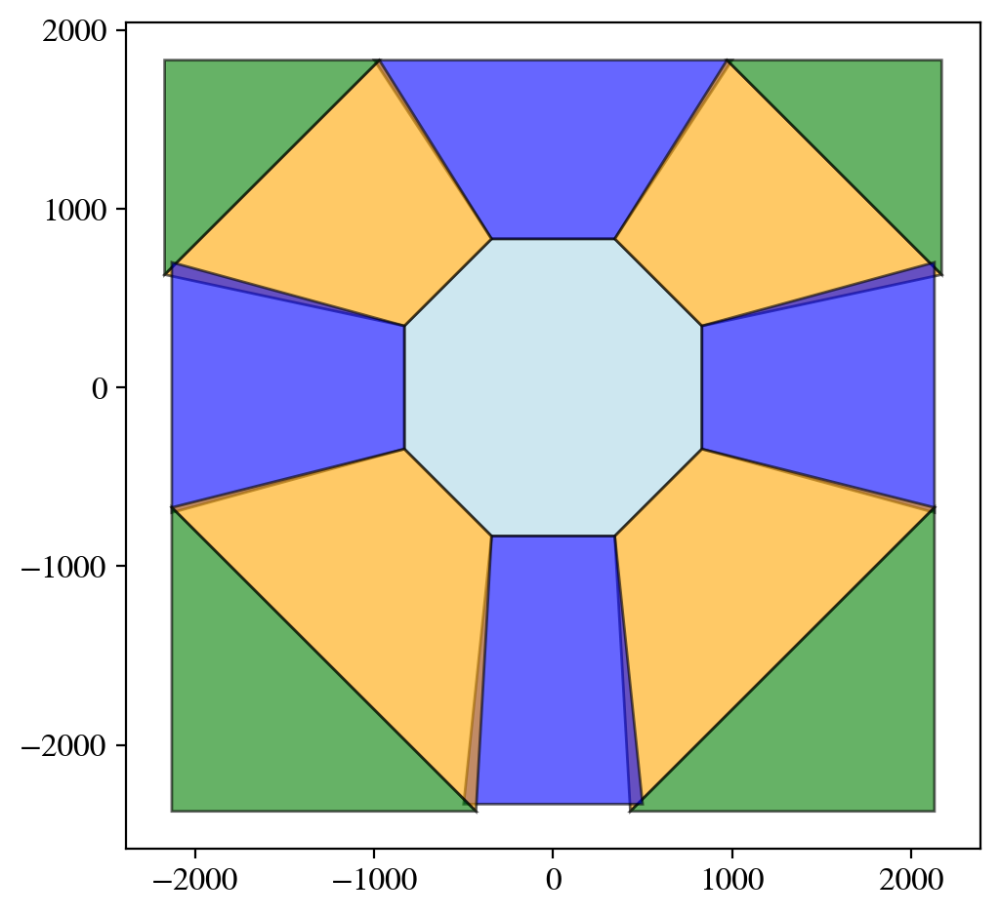

In [64]:
import matplotlib.pyplot as plt
import numpy as np

def regular_polygon(n_sides, radius=1.0, center=(0,0), rotation=0):
    cx, cy = center
    angles = np.linspace(0, 2*np.pi, n_sides, endpoint=False) + rotation
    return [(cx + radius*np.cos(a), cy + radius*np.sin(a)) for a in angles]

def add_trapezoid(ax, base_p1, base_p2, height, opposite_side,
                  right_side=None, left_side=None,
                  polygon_center=None, color="orange", is_isosceles=False):
    p1 = np.array(base_p1)
    p2 = np.array(base_p2)

    edge_vec = p2 - p1
    edge_len = np.linalg.norm(edge_vec)
    edge_dir = edge_vec / edge_len
    perp = np.array([-edge_dir[1], edge_dir[0]])

    # Ensure perpendicular points outward
    if polygon_center is not None:
        midpoint = (p1 + p2) / 2
        to_center = np.array(polygon_center) - midpoint
        if np.dot(perp, to_center) > 0:
            perp = -perp

    if is_isosceles:
        shift = (edge_len - opposite_side) / 2
        outer_p1 = p1 + perp * height + edge_dir * shift
        outer_p2 = p2 + perp * height - edge_dir * shift
        left_side = right_side = np.sqrt(shift**2 + height**2)
    else:
        if right_side is None and left_side is None:
            raise ValueError("You must provide either right_side or left_side, or set is_isosceles=True.")
        if right_side is not None and left_side is not None:
            raise ValueError("Provide only one of right_side or left_side, or set is_isosceles=True.")
        if right_side is not None:
            along_shift = np.sqrt(max(right_side**2 - height**2, 0))
            outer_p2 = p2 + perp * height + edge_dir * along_shift
            outer_p1 = outer_p2 - edge_dir * opposite_side
            left_side = np.linalg.norm(outer_p1 - p1)
        elif left_side is not None:
            along_shift = np.sqrt(max(left_side**2 - height**2, 0))
            outer_p1 = p1 + perp * height - edge_dir * along_shift
            outer_p2 = outer_p1 + edge_dir * opposite_side
            right_side = np.linalg.norm(outer_p2 - p2)

    ax.fill([p1[0], p2[0], outer_p2[0], outer_p1[0]],
            [p1[1], p2[1], outer_p2[1], outer_p1[1]],
            color=color, alpha=0.6, edgecolor="black")

    return outer_p1, outer_p2, left_side, right_side

def add_triangle_on_edge(ax, edge_p1, edge_p2, side1, side2,
                         polygon_center=None, color="red"):
    """
    Add a triangle to a given edge (edge_p1 -> edge_p2), with specified lengths
    from each base vertex to the tip (side1 and side2).
    
    The function chooses the tip position outward from polygon_center.
    """
    p1 = np.array(edge_p1)
    p2 = np.array(edge_p2)

    # Base length
    base_len = np.linalg.norm(p2 - p1)

    # Check triangle inequality
    if not (side1 + side2 > base_len and
            side1 + base_len > side2 and
            side2 + base_len > side1):
        raise ValueError("Invalid side lengths: do not satisfy triangle inequality.")

    # Midpoint and base direction
    edge_dir = (p2 - p1) / base_len
    perp = np.array([-edge_dir[1], edge_dir[0]])

    # Ensure perpendicular points outward
    if polygon_center is not None:
        midpoint = (p1 + p2) / 2
        to_center = np.array(polygon_center) - midpoint
        if np.dot(perp, to_center) > 0:
            perp = -perp

    # Law of cosines to get perpendicular height from base to tip
    # Using formula for distance from tip to base: h² = side1² - x²
    # where x is projection from p1 to perpendicular foot
    x = (side1**2 - side2**2 + base_len**2) / (2 * base_len)
    h = np.sqrt(max(side1**2 - x**2, 0))

    # Tip coordinates
    tip = p1 + edge_dir * x + perp * h

    # Draw triangle
    ax.fill([p1[0], p2[0], tip[0]],
            [p1[1], p2[1], tip[1]],
            color=color, alpha=0.6, edgecolor="black")

    return tip


# --- Example ---
fig, ax = plt.subplots()

R, L1, h1, gamma, h3, h5 = 900, 2000, 1000, np.pi/4, 1300, 1500
l, d1, h2, d2, L2, L3 = getT2T3fromT1(R, L1, h1, gamma, h3)
print("l, d1, h2, d2, L2, L3 = ")
print(l, d1, h2, d2, L2, L3)

l, d3, h4, d4, L4, L5 = getT2T3fromT1(R, L3, h3, gamma, h5)
print("l, d3, h4, d4, L4, L5 = ")
print(l, d3, h4, d4, L4, L5)

Da = 2*R + h1 + h5
Db = 2*(R + h3)

ht1 = R + h1 - L3/2
ht3 = R + h3 - L1/2
htm1 = R + h5 - L3/2
ht5 = R + h3 - L5/2



# Rotated octagon
octagon = regular_polygon(8, radius=900, rotation=3*np.pi/8)
oct_x, oct_y = zip(*octagon)
ax.fill(oct_x, oct_y, color="lightblue", alpha=0.6, edgecolor="black")

# Center
center = np.mean(octagon, axis=0)

# Add isosceles trapezoid on another side
base_p1, base_p2 = octagon[0], octagon[1]
outer_p1, outer_p2, left_len, right_len = add_trapezoid(ax, base_p1, base_p2,
                                    height=h1, opposite_side=L1,
                                    is_isosceles=True,
                                    polygon_center=center,
                                    color="blue")
print("Isosceles sides:", left_len, right_len)

# Add trapezoid with right_side given
base_p1, base_p2 = octagon[-1], octagon[0]
outer_p1, outer_p2, left_len, right_len = add_trapezoid(ax, base_p1, base_p2,
                                    height=h2, opposite_side=L2,
                                    right_side=d1,
                                    polygon_center=center,
                                    color="orange")
print("Right given:", right_len)
print("-> Left length:", left_len)

# Add triangle on top of trapezoid's outer edge
add_triangle_on_edge(ax, outer_p1, outer_p2,
                     side1=ht3, side2=ht1,
                     polygon_center=center, color="green")

# Add isosceles trapezoid on another side
base_p1, base_p2 = octagon[-2], octagon[-1]
outer_p1, outer_p2, left_len, right_len = add_trapezoid(ax, base_p1, base_p2,
                                    height=h3, opposite_side=L3,
                                    is_isosceles=True,
                                    polygon_center=center,
                                    color="blue")
print("Isosceles sides:", left_len, right_len)

# Add trapezoid with right_side given
base_p1, base_p2 = octagon[-3], octagon[-2]
outer_p1, outer_p2, left_len, right_len = add_trapezoid(ax, base_p1, base_p2,
                                    height=h4, opposite_side=L4,
                                    right_side=d3,
                                    polygon_center=center,
                                    color="orange")
print("Right given:", right_len)
print("-> Left length:", left_len)

# Add triangle on top of trapezoid's outer edge
add_triangle_on_edge(ax, outer_p1, outer_p2,
                     side1=htm1, side2=ht5,
                     polygon_center=center, color="green")

# Add isosceles trapezoid on another side
base_p1, base_p2 = octagon[-4], octagon[-3]
outer_p1, outer_p2, left_len, right_len = add_trapezoid(ax, base_p1, base_p2,
                                    height=h5, opposite_side=L5,
                                    is_isosceles=True,
                                    polygon_center=center,
                                    color="blue")
print("Isosceles sides:", left_len, right_len)

# Add trapezoid with right_side given
base_p1, base_p2 = octagon[1], octagon[2]
outer_p1, outer_p2, left_len, right_len = add_trapezoid(ax, base_p1, base_p2,
                                    height=h2, opposite_side=L2,
                                    left_side=d1,
                                    polygon_center=center,
                                    color="orange")
print("Left given:", left_len)
print("-> Right length:", right_len)

# Add triangle on top of trapezoid's outer edge
add_triangle_on_edge(ax, outer_p1, outer_p2,
                     side1=ht1, side2=ht3,
                     polygon_center=center, color="green")

# Add isosceles trapezoid on another side
base_p1, base_p2 = octagon[2], octagon[3]
outer_p1, outer_p2, left_len, right_len = add_trapezoid(ax, base_p1, base_p2,
                                    height=h3, opposite_side=L3,
                                    is_isosceles=True,
                                    polygon_center=center,
                                    color="blue")
print("Isosceles sides:", left_len, right_len)

# Add trapezoid with right_side given
base_p1, base_p2 = octagon[3], octagon[4]
outer_p1, outer_p2, left_len, right_len = add_trapezoid(ax, base_p1, base_p2,
                                    height=h4, opposite_side=L4,
                                    left_side=d3,
                                    polygon_center=center,
                                    color="orange")
print("Left given:", left_len)
print("-> Right length:", right_len)

# Add triangle on top of trapezoid's outer edge
add_triangle_on_edge(ax, outer_p1, outer_p2,
                     side1=ht5, side2=htm1,
                     polygon_center=center, color="green")


ax.set_aspect("equal")
plt.show()


In [65]:
frontcrv2b = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [66]:
Ls=[3000, 3000, 3000, 2800]
ls=[1040, 1240, 1240, 1240]

frontcrv2b.getGeometry(nstrips=48, xmin=-2120, xmax=2120, ymin=-2120, ymax=2120, L=Ls, l=ls, geo_type='rectangular strips 2b')
frontcrv2b.getHitsPerChannel()

y_off = 200


In [67]:
HitRateArr = []
for i in range(frontcrv2b.geometry.nstrips):
    HitRateArr.append(frontcrv2b.module1Hits[i])
    HitRateArr.append(frontcrv2b.module2Hits[i])
    HitRateArr.append(frontcrv2b.module3Hits[i])
    HitRateArr.append(frontcrv2b.module4Hits[i])
AvgHitRatePerStrip2b = np.mean(HitRateArr)
AvgHitRatePerStrip2b/1000

92.32935981180259

AvgHitRatePerStrip = 92.33 kHz
max_hit_rate = 530.00 kHz/strip


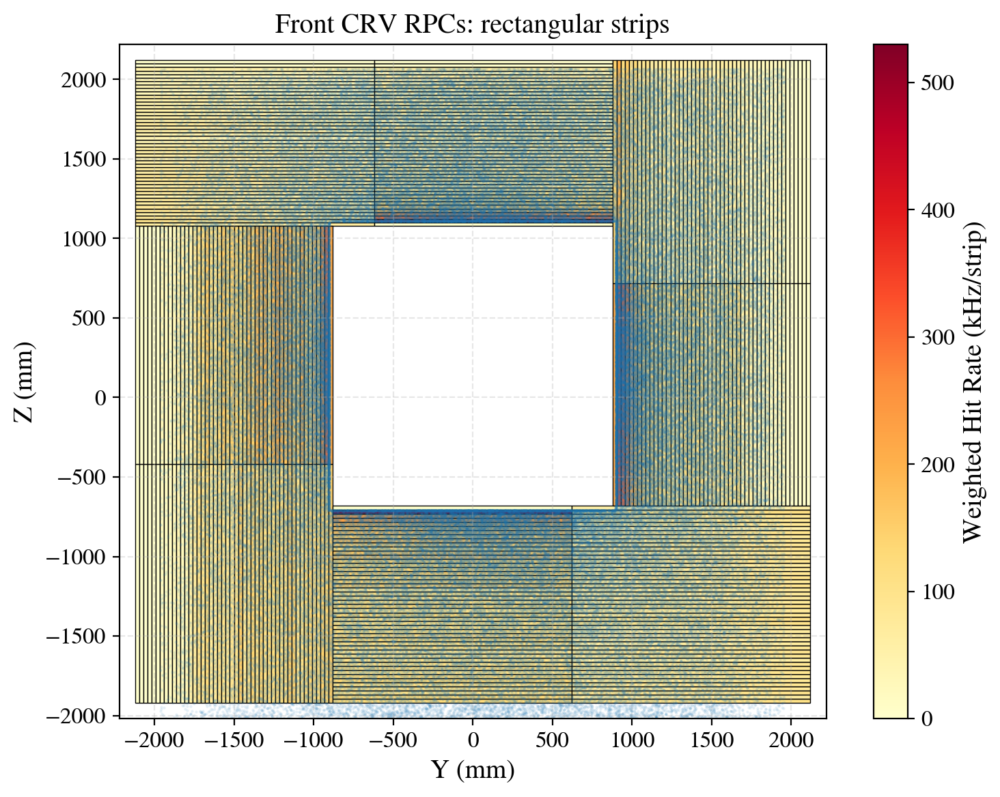

In [68]:
print("AvgHitRatePerStrip = {:.2f} kHz".format(AvgHitRatePerStrip2b/1000))
plot_strip_hitmap(frontcrv2b, plotHits=True)

In [69]:
frontcrv3 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [70]:
frontcrv3.getGeometry(nstrips=24, xmin=-2120, xmax=2120, ymin=-2120, ymax=2120, L=1500, geo_type='trapezoidal strips')
frontcrv3.getHitsPerChannel()

Trapezoidal module dimensions: L = 4240, l = 1240, H = 1500


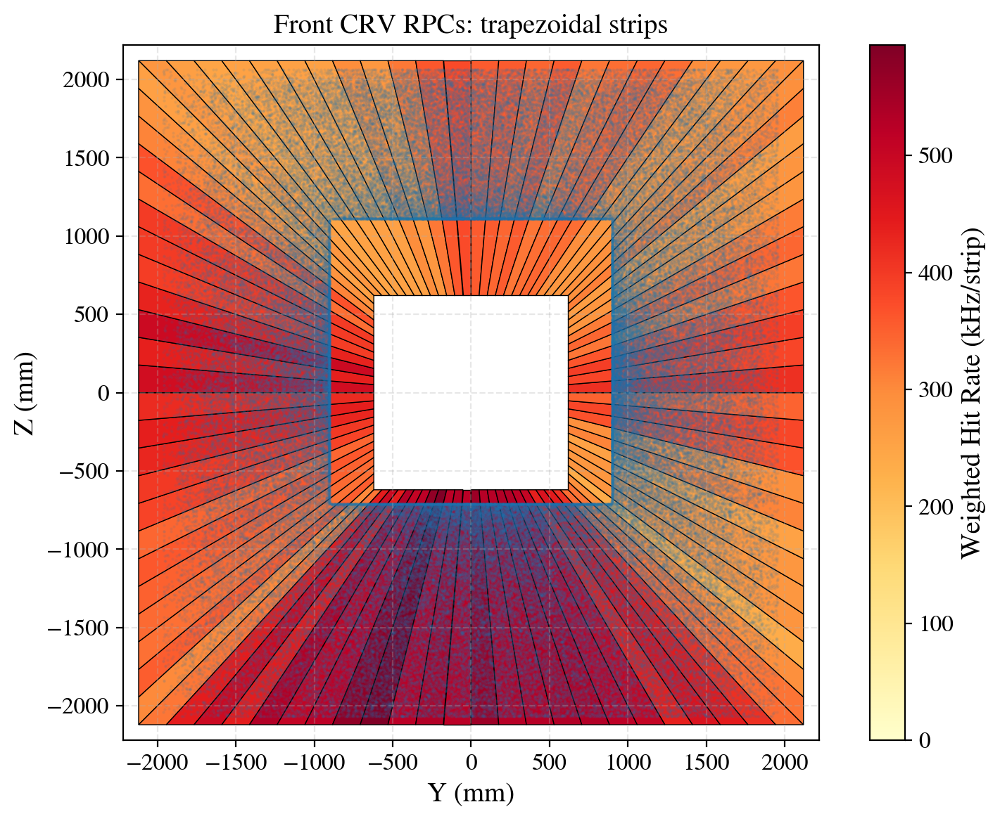

In [71]:
plot_trapezoidal_strip_hitmap(frontcrv3, plotHits=True)

In [72]:
np.stack([[1,2,3], [4,5,6]], axis=1)

array([[1, 4],
       [2, 5],
       [3, 6]])

In [73]:
stripPitch = 0.1*frontcrv1.geometry.pitch ## in cm
stripSurface = stripPitch * 0.1*frontcrv1.geometry.l ## in cm2
# stripSurface = stripPitch * 0.1*frontcrv1.geometry.L ## in cm2

stripPitch, stripSurface

(2.854166666666667, 428.12500000000006)

In [74]:
module1Hits_arr = np.array([ d for i,d in frontcrv1.module1Hits.items()])

np.mean(module1Hits_arr), np.mean(module1Hits_arr)/stripSurface

(76069.02734899335, 177.67947993925452)

In [75]:
frontcrv1.module1Hits

{0: 0,
 1: 0,
 2: 0,
 3: 0,
 4: 0,
 5: 12655.15492949971,
 6: 12020.697398193372,
 7: 18896.103374178532,
 8: 18760.04450322851,
 9: 23264.015638445024,
 10: 38565.937464324445,
 11: 24366.70192351121,
 12: 49299.482540703444,
 13: 89584.83017711612,
 14: 76291.41926539864,
 15: 121628.33115079282,
 16: 108772.7312016487,
 17: 54646.03792574808,
 18: 69347.16678676632,
 19: 113003.41960780586,
 20: 79786.52612500092,
 21: 79071.69808961905,
 22: 78015.24403475419,
 23: 94421.20383579854,
 24: 89171.76064437004,
 25: 100184.78389742834,
 26: 120660.5545579459,
 27: 115445.67229067304,
 28: 113463.48040594932,
 29: 136141.66828685201,
 30: 116747.67325619758,
 31: 121432.05699621883,
 32: 133733.05142917673,
 33: 148781.89013653158,
 34: 91576.26253780059,
 35: 149488.94570858916,
 36: 119326.33980436691,
 37: 101318.75011502882,
 38: 103647.58488214985,
 39: 92217.91233003773,
 40: 79196.19105154292,
 41: 111569.28333168112,
 42: 137720.12877048747,
 43: 57317.079294145165,
 44: 56201.7

In [116]:
frontcrv4 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [117]:
frontcrv4.getNewGeometry(nstrips=4, R=870, L1=2200, h1=1030, h3=1150, h5=1450)
# frontcrv4.getNewGeometry(nstrips=5)
frontcrv4.getHitsPerChannel()

(alpha1, alpha2, beta2) = (0.70, 0.551768, 0.592687) pi
l, d1, h2, d2, L2, L3 = 
720.7315985291855 1268.053134098688 1251.3203435596427 1306.3102781196385 1301.0764773832473 1960.0000000000005
(alpha1, alpha2, beta2) = (0.66, 0.592687, 0.680937) pi
l, d3, h4, d4, L4, L5 = 
720.7315985291855 1306.3102781196385 1251.3203435596427 1484.8117800851937 1895.046173579947 1359.9999999999973


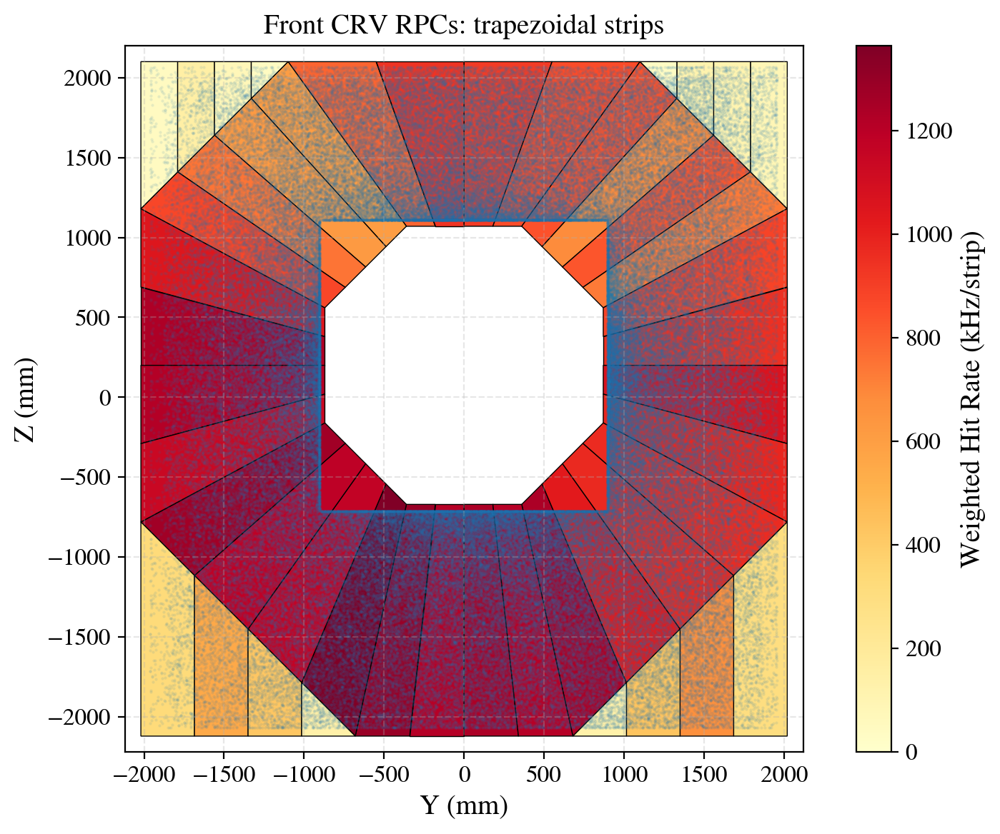

In [118]:
plot_trapezoidal_strip_hitmap(frontcrv4, plotHits=True)

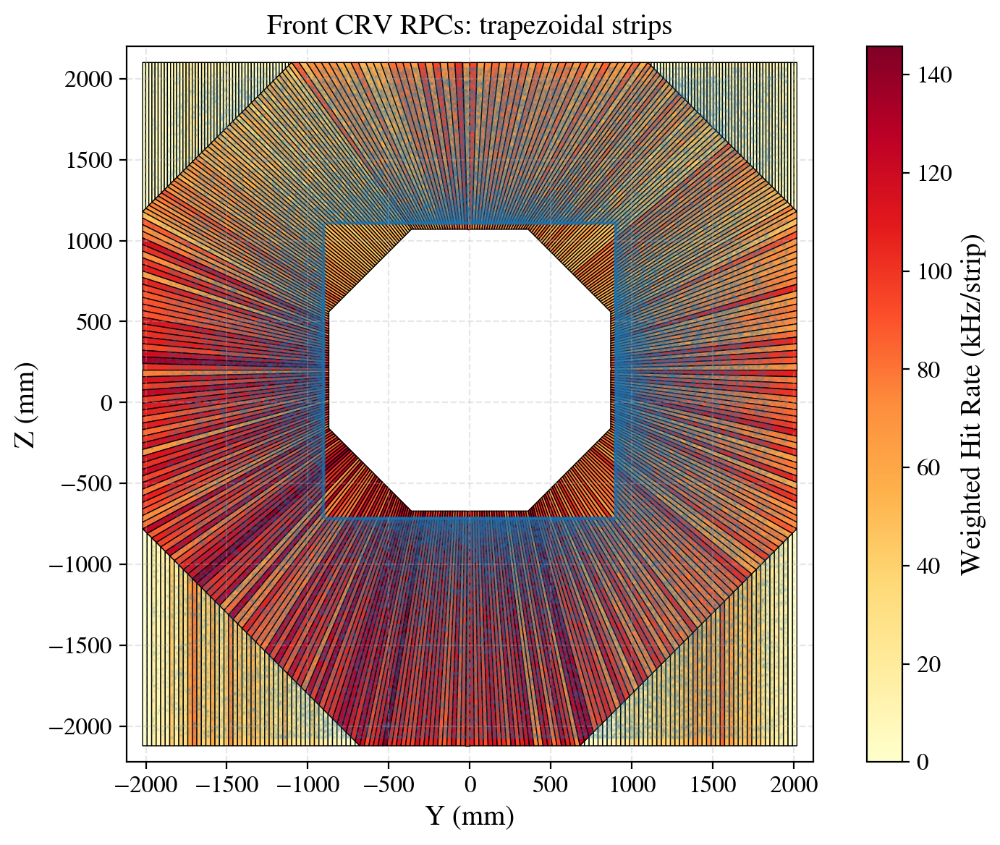

In [78]:
plot_trapezoidal_strip_hitmap(frontcrv4, plotHits=True)

In [79]:
### max PCB dims: 570mm wide (perpendicular to strips) x 1500mm long (parallel to strips)

h_values = [getattr(frontcrv4.geometry, f"h{i}") for i in range(1, 6)]
print("Module lengths = ", ", ".join(f"{v:.0f}" for v in h_values))
L_values = [getattr(frontcrv4.geometry, f"L{i}") for i in range(1, 6)]
print("Module long width = ", ", ".join(f"{v:.0f}" for v in L_values))
print("Module short width = ", "{:.0f}".format(frontcrv4.geometry.l))

nPCBperModule = 4  ### parallel PCBs along strip length, one row only.
maxPCBwidths = np.array(L_values)/nPCBperModule
minPCBwidth = frontcrv4.geometry.l/nPCBperModule
print("PCB max widths = ", ", ".join(f"{v:.0f}" for v in maxPCBwidths))
print("PCB min width = {:.0f}".format(minPCBwidth))

Module lengths =  1030, 1251, 1150, 1251, 1450
Module long width =  2200, 1301, 1960, 1895, 1360
Module short width =  721
PCB max widths =  550, 325, 490, 474, 340
PCB min width = 180


In [80]:
### max PCB dims: 570mm wide (perpendicular to strips) x 1500mm long (parallel to strips)

h_values = [getattr(frontcrv4.geometry, f"h{i}") for i in range(1, 6)]
print("Module lengths = ", ", ".join(f"{v:.0f}" for v in h_values))
L_values = [getattr(frontcrv4.geometry, f"L{i}") for i in range(1, 6)]
print("Module long width = ", ", ".join(f"{v:.0f}" for v in L_values))
print("Module short width = ", "{:.0f}".format(frontcrv4.geometry.l))

nPCBperModule = 4  ### parallel PCBs along strip length, one row only.
maxPCBwidths = np.array(L_values)/nPCBperModule
minPCBwidth = frontcrv4.geometry.l/nPCBperModule
print("PCB max widths = ", ", ".join(f"{v:.0f}" for v in maxPCBwidths))
print("PCB min width = {:.0f}".format(minPCBwidth))


Module lengths =  1030, 1251, 1150, 1251, 1450
Module long width =  2200, 1301, 1960, 1895, 1360
Module short width =  721
PCB max widths =  550, 325, 490, 474, 340
PCB min width = 180


In [81]:
"; ".join(['1.235', '2.346', '3.400'])  

'1.235; 2.346; 3.400'

In [137]:
frontcrv4b = CRVHitMap("../Root_outputs/CRVAnalysis.root")

pdf norm = 1.59e+02
pdf norm = 1.26e+00
n_square_frame = 66352
pdf norm = 8.85e-02
66352
79290
31347
26232
n_ring_frame = 26232
n_square_frame = 66352


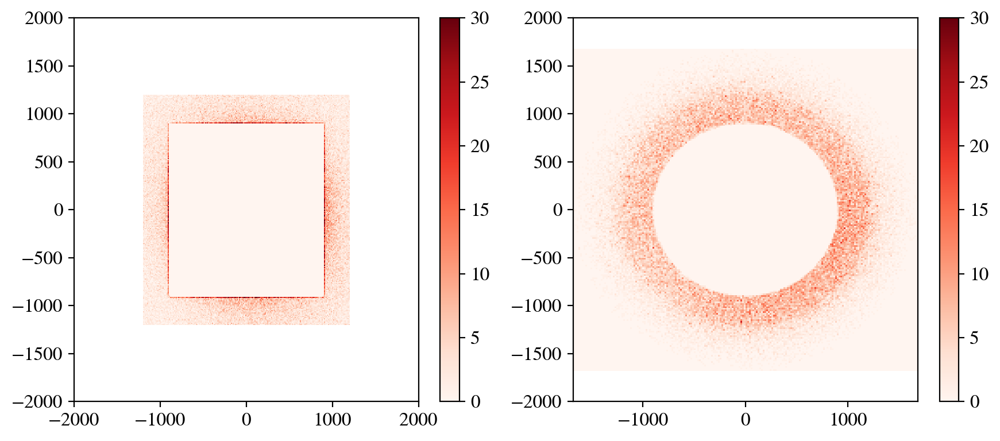

In [138]:
yoff = -3
zoff = 206
nbins = 1000 # for inverse transform sampling
l = 2*900 # frame inner width (hit window width)
L = 2*1200 # frame outer width (select center hits)
norm = mcolors.Normalize(vmin=0, vmax=30)

yabs = L//2
ymin, ymax = -yabs + yoff, yabs + yoff
zmin, zmax = -yabs + zoff, yabs + zoff

## get hits inside square frame in centered cartesian frame
y_all, z_all = getCenterHitsFromMap(frontcrv4b, ymin, ymax, zmin, zmax)
y_all, z_all = y_all - yoff, z_all - zoff

## 1D radial generation
nsamples = len(y_all)
rho = np.sqrt(y_all**2 + z_all**2)
phi = np.arctan2(z_all, y_all)
phi_new = generateFromDist(phi, nbins, nsamples)
rho_new = generateFromDist(rho, nbins, nsamples)

## y,z from radial generation
y_new = rho_new*np.cos(phi_new)
z_new = rho_new*np.sin(phi_new)

fig, axs = plt.subplots(1, 2, tight_layout=True, figsize=(9,4))
hist = axs[0].hist2d(y_all, z_all, 200, cmap='Reds', shading='auto', alpha=1, norm=norm)
hist2 = axs[1].hist2d(y_new, z_new, 200, cmap='Reds', shading='auto', alpha=1, norm=norm)
axs[0].set_xlim(-2000, 2000)
axs[0].set_ylim(-2000, 2000)
axs[1].set_ylim(-2000, 2000)
axs[1].set_ylim(-2000, 2000)
plt.colorbar(hist[3], ax=axs[0])
plt.colorbar(hist2[3], ax=axs[1])


print("n_square_frame = {}".format(nsamples))
y_ring, z_ring, y_frame, z_frame = generateFromDist_2D_masked(y_new, z_new, nbins, nsamples, l, L)
print("n_ring_frame = {}".format(len(y_ring)))
print("n_square_frame = {}".format(len(y_frame)))

26232
163669


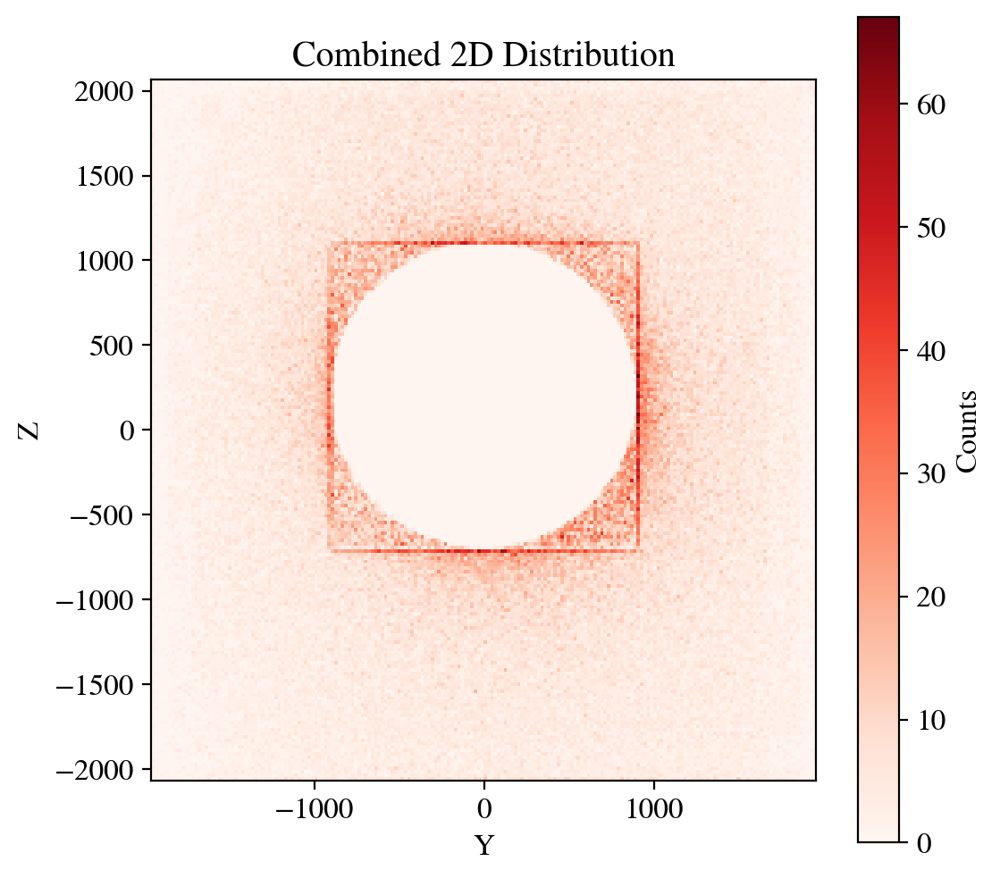

In [139]:
# Combine data
y_ring_real = y_ring + yoff
z_ring_real = z_ring + zoff
print(len(y_ring_real))
y_all_real = frontcrv4b.HitY
z_all_real = frontcrv4b.HitZ
print(len(y_all_real))

y_combined = np.concatenate([y_all_real, y_ring_real])
z_combined = np.concatenate([z_all_real, z_ring_real])
# y_combined = np.concatenate([y_all])
# z_combined = np.concatenate([z_all])

# Plot combined distribution
plt.figure(figsize=(6, 6))
plt.hist2d(y_combined, z_combined, bins=200, cmap="Reds")
# plt.hist2d(y_all_real, z_all_real, bins=150, cmap="Reds")
plt.gca().set_aspect("equal")
plt.xlabel("Y")
plt.ylabel("Z")
plt.title("Combined 2D Distribution")
plt.colorbar(label="Counts")
plt.show()


In [140]:
np.concatenate([np.array([1, 2, 3]), np.array([7, 8])])

array([1, 2, 3, 7, 8])

In [141]:
## scaled nHits for redistribution 
nExtaHits = len(y_ring_real)
nHits_4b = frontcrv4b.nhits + nExtaHits
nPOT_4b = nHits_4b / nHitsPerPOT

nExtaHits/1e6, nHits/1e6, nHits_4b/1e6, nPOT/1e6, nPOT_4b/1e6

(0.026232, 0.163669, 0.189901, 99.995, 116.02166870329751)

In [142]:
extra_weights_dist_4b = generateFromDist(frontcrv4b.RPCweights, int(1e5), nExtaHits)
len(frontcrv4b.RPCweights), len(extra_weights_dist_4b)

pdf norm = 1.15e+05


(163669, 26232)

In [143]:
### use generated YZ hits and generated weights instead, and scale number of POTs.
frontcrv4b.HitY = y_combined
frontcrv4b.HitZ = z_combined
frontcrv4b.RPCweights = np.concatenate([frontcrv4b.RPCweights, extra_weights_dist_4b])
frontcrv4b.nPOT = nPOT_4b
frontcrv4b.nhits = nHits_4b

In [144]:
frontcrv4b.getNewGeometry(nstrips=48, R=870, L1=2200, h1=1030, h3=1150, h5=1450)
# frontcrv4.getNewGeometry(nstrips=5)
frontcrv4b.getHitsPerChannel()

(alpha1, alpha2, beta2) = (0.70, 0.551768, 0.592687) pi
l, d1, h2, d2, L2, L3 = 
720.7315985291855 1268.053134098688 1251.3203435596427 1306.3102781196385 1301.0764773832473 1960.0000000000005
(alpha1, alpha2, beta2) = (0.66, 0.592687, 0.680937) pi
l, d3, h4, d4, L4, L5 = 
720.7315985291855 1306.3102781196385 1251.3203435596427 1484.8117800851937 1895.046173579947 1359.9999999999973


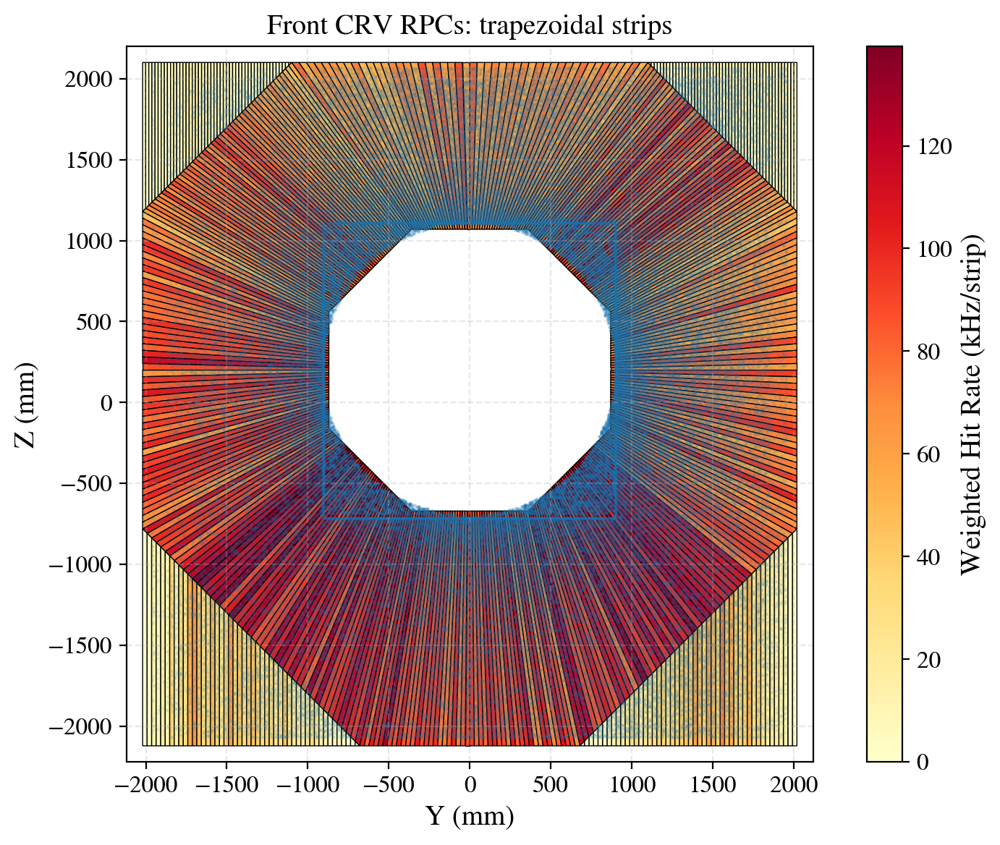

In [145]:
plot_trapezoidal_strip_hitmap(frontcrv4b, plotHits=True)

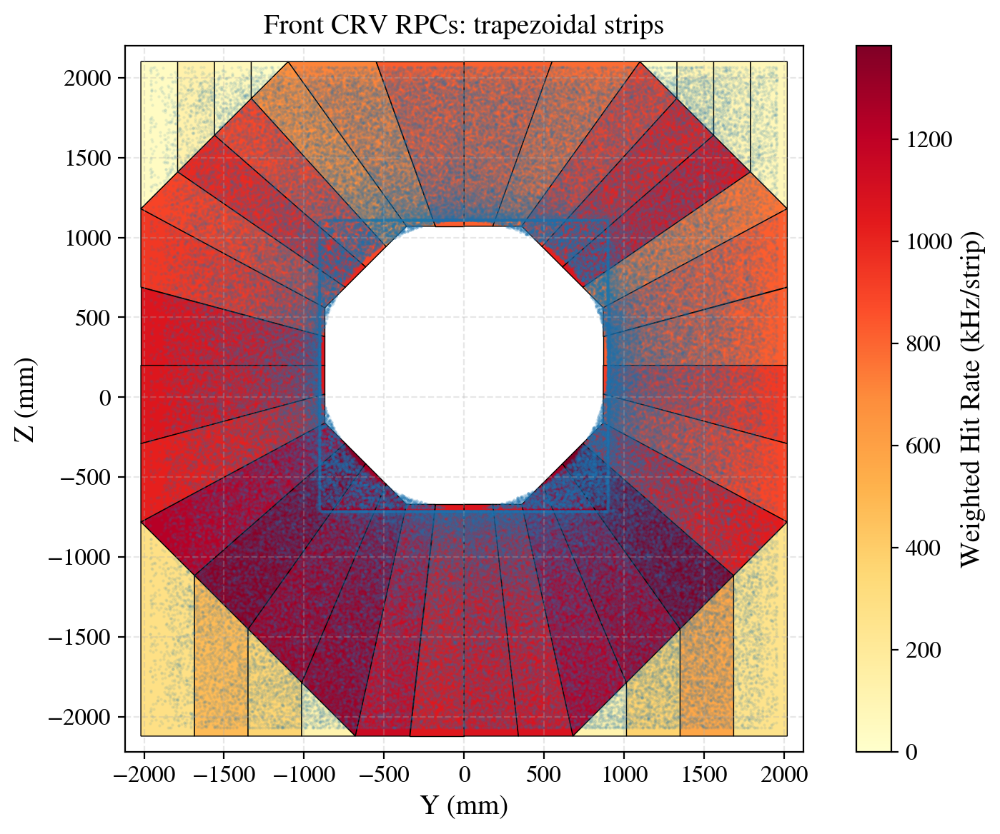

In [127]:
plot_trapezoidal_strip_hitmap(frontcrv4b, plotHits=True)

In [146]:
frontcrv4b.geometry.module1strips

{0: <POLYGON ((-1100 2100, -1054.167 2100, -345.351 1070, -360.366 1070, -1100 2...>,
 1: <POLYGON ((-1054.167 2100, -1008.333 2100, -330.335 1070, -345.351 1070, -10...>,
 2: <POLYGON ((-1008.333 2100, -962.5 2100, -315.32 1070, -330.335 1070, -1008.3...>,
 3: <POLYGON ((-962.5 2100, -916.667 2100, -300.305 1070, -315.32 1070, -962.5 2...>,
 4: <POLYGON ((-916.667 2100, -870.833 2100, -285.29 1070, -300.305 1070, -916.6...>,
 5: <POLYGON ((-870.833 2100, -825 2100, -270.274 1070, -285.29 1070, -870.833 2...>,
 6: <POLYGON ((-825 2100, -779.167 2100, -255.259 1070, -270.274 1070, -825 2100))>,
 7: <POLYGON ((-779.167 2100, -733.333 2100, -240.244 1070, -255.259 1070, -779....>,
 8: <POLYGON ((-733.333 2100, -687.5 2100, -225.229 1070, -240.244 1070, -733.33...>,
 9: <POLYGON ((-687.5 2100, -641.667 2100, -210.213 1070, -225.229 1070, -687.5 ...>,
 10: <POLYGON ((-641.667 2100, -595.833 2100, -195.198 1070, -210.213 1070, -641....>,
 11: <POLYGON ((-595.833 2100, -550 2100, -180.183 107

In [148]:
frontcrv4b.stripHits

{0: 79370.52616208259,
 1: 52475.681268484295,
 2: 66332.0679988969,
 3: 66477.3967768297,
 4: 62656.19761042135,
 5: 65421.19498307799,
 6: 55024.37355940835,
 7: 53763.9324180439,
 8: 72807.3942502317,
 9: 47003.38483561452,
 10: 52308.52805790812,
 11: 53793.391248412634,
 12: 55771.50533096147,
 13: 70402.36041882819,
 14: 71063.99707210653,
 15: 67297.35454015706,
 16: 55411.36317410245,
 17: 86867.40694468598,
 18: 61343.864624111615,
 19: 80826.05663466081,
 20: 60078.58212844084,
 21: 68982.20240497762,
 22: 86853.94152597878,
 23: 57600.45381032081,
 24: 80347.00188137141,
 25: 55799.20654326301,
 26: 64636.239009990626,
 27: 72064.03492751346,
 28: 57247.6979076249,
 29: 70452.60448142009,
 30: 67275.19246330102,
 31: 71417.1414885339,
 32: 55131.2859147242,
 33: 73789.0918195714,
 34: 65246.31019867821,
 35: 60650.89696870435,
 36: 72461.47368549189,
 37: 69187.434367129,
 38: 59367.02007758045,
 39: 76314.60896309829,
 40: 60769.099154564,
 41: 58932.486901253455,
 42: 7778

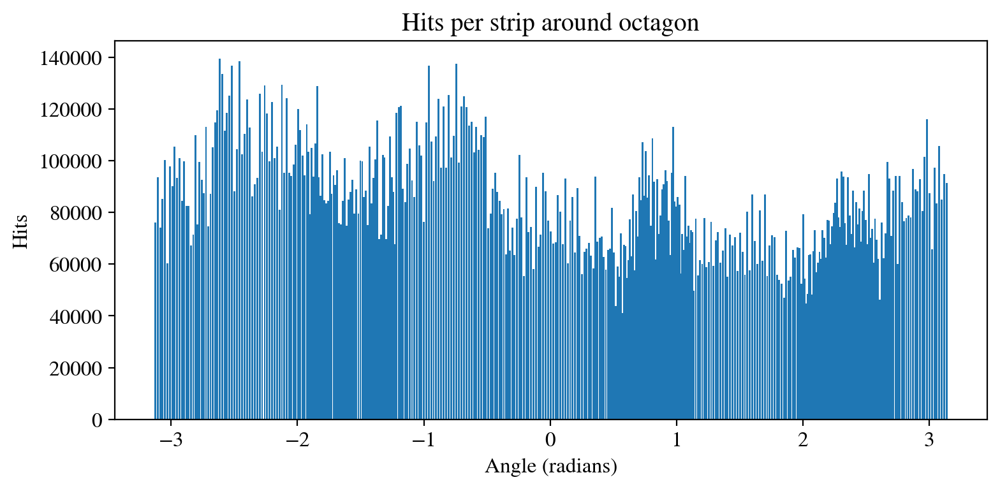

In [167]:
import numpy as np
import matplotlib.pyplot as plt

# Example: frontcrv4b.stripHits is your hit dictionary
stripHits = frontcrv4b.stripHits
stripPolygons = frontcrv4b.geometry.module1strips  # and others for all modules

all_strips = {}
for m in range(1, 9):  # modules 1 to 8
    strips = getattr(frontcrv4b.geometry, f"module{m}strips")
    all_strips.update(strips)

angles = {}
for strip_id, poly in all_strips.items():
    cx, cy = poly.centroid.coords[0]
    angles[strip_id] = np.arctan2(cy, cx)

# Only keep IDs that exist in both
common_ids = stripHits.keys() & angles.keys()

sorted_ids = sorted(common_ids, key=lambda sid: angles[sid])
sorted_hits = [stripHits[sid] for sid in sorted_ids]
sorted_angles = [angles[sid] for sid in sorted_ids]

# plot
plt.figure(figsize=(8, 4))
# dx = sorted_angles[1] - sorted_angles[0]  # approximate spacing
# plt.bar(sorted_angles, sorted_hits, width=dx*0.9, align='center')
plt.bar(sorted_angles, sorted_hits, width=(2*np.pi/384)*0.9, align='center')
# plt.bar(sorted_angles[50:150], sorted_hits[50:150], width=(2*np.pi/384)*0.5, align='center')
plt.xlabel("Angle (radians)")
plt.ylabel("Hits")
plt.title("Hits per strip around octagon")
# plt.xticks(np.linspace(-np.pi, np.pi, 9),  # 9 ticks from -π to π
#            [f"{a:.2f}" for a in np.linspace(-np.pi, np.pi, 9)])
plt.tight_layout()
plt.show()


In [160]:
sorted_angles, sorted_hits

([-3.125715467990375,
  -3.106223531074717,
  -3.086758440921599,
  -3.067334850795729,
  -3.0479672264783733,
  -3.028669782814154,
  -3.0094564230446337,
  -2.9903406815532794,
  -2.97133567057772,
  -2.9524540313671945,
  -2.9337078901782254,
  -2.915108819412233,
  -2.8966678041077194,
  -2.8783952139091,
  -2.860300780546595,
  -2.8423935807787926,
  -2.8246820246732485,
  -2.8081091044284903,
  -2.7917276775810365,
  -2.775092661187064,
  -2.7582075398516985,
  -2.7410764738541156,
  -2.7237043225877304,
  -2.70609666481107,
  -2.688259815208497,
  -2.6702008367648817,
  -2.6519275484740055,
  -2.6334485279278748,
  -2.614773108373948,
  -2.5959113698798446,
  -2.5768741243104625,
  -2.55767289390004,
  -2.5383198832906424,
  -2.5188279450073656,
  -2.4992105384472794,
  -2.479481682571371,
  -2.4596559026036737,
  -2.4397481711562623,
  -2.4197738443095047,
  -2.3997485932805303,
  -2.379688332405909,
  -2.359609144244048,
  -2.3395272026659524,
  -2.3194586948476767,
  -2.29941